
#### gdown

In [1]:
! pip install --upgrade gdown

  Attempting uninstall: gdown
    Found existing installation: gdown 5.1.0
    Uninstalling gdown-5.1.0:
      Successfully uninstalled gdown-5.1.0


#### ___

In [2]:
import gdown
import os
import zipfile as zf

from pathlib import Path

In [3]:
KAGGLE_API_TOKEN_DIR = Path('/root/.kaggle')
KAGGLE_API_TOKEN_ID = '1ngLbg11gU9kd1QxsCrUW66KV1rSENZ3E'

KAGGLE_COMPETITION = 'home-credit-default-risk'

DATA_DIR = Path('/content/data')

In [4]:
KAGGLE_API_TOKEN_DIR.mkdir(exist_ok=True)

gdown.download(
    id=KAGGLE_API_TOKEN_ID,
    output=str(KAGGLE_API_TOKEN_DIR / 'kaggle.json')
)

os.chmod(str(KAGGLE_API_TOKEN_DIR / 'kaggle.json'), 0o600)

Downloading...
From: https://drive.google.com/uc?id=1ngLbg11gU9kd1QxsCrUW66KV1rSENZ3E
To: /root/.kaggle/kaggle.json
100%|██████████| 70.0/70.0 [00:00<00:00, 19.8kB/s]


In [5]:
! kaggle competitions download -c {KAGGLE_COMPETITION}

 99% 681M/688M [00:07<00:00, 95.5MB/s]
100% 688M/688M [00:07<00:00, 90.4MB/s]


In [6]:
DATA_DIR.mkdir(exist_ok=True)

with zf.ZipFile(f'{KAGGLE_COMPETITION}.zip', 'r') as zh:
    zh.extractall(str(DATA_DIR))

## Mining

In [7]:
import numpy as np
import pandas as pd

pd.set_option('display.max_columns', None)

In [8]:
df_app = pd.read_csv(str(DATA_DIR / 'application_train.csv'), sep=',')

In [ ]:
df_app

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.0220,0.0198,0.0,0.0000,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.0000,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.0790,0.0554,0.0,0.0000,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.0100,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [ ]:
df_app.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [ ]:
df_app.nunique()

SK_ID_CURR                    307511
TARGET                             2
NAME_CONTRACT_TYPE                 2
CODE_GENDER                        3
FLAG_OWN_CAR                       2
                               ...  
AMT_REQ_CREDIT_BUREAU_DAY          9
AMT_REQ_CREDIT_BUREAU_WEEK         9
AMT_REQ_CREDIT_BUREAU_MON         24
AMT_REQ_CREDIT_BUREAU_QRT         11
AMT_REQ_CREDIT_BUREAU_YEAR        25
Length: 122, dtype: int64

### Description

- bureau_balance нужно придумать как аггрегировать

In [9]:
df_info = pd.read_csv(
    str(DATA_DIR / 'HomeCredit_columns_description.csv'), sep=',',
    encoding='cp1252')

In [ ]:
df_info['Table'].unique()

array(['application_{train|test}.csv', 'bureau.csv', 'bureau_balance.csv',
       'POS_CASH_balance.csv', 'credit_card_balance.csv',
       'previous_application.csv', 'installments_payments.csv'],
      dtype=object)

In [10]:
normal_cols = []

In [ ]:
normal_cols

[]

In [11]:
from IPython.display import display, HTML

In [12]:
html_info = ""
tables = df_info['Table'].unique()

for table in tables:
    html_info += f"<h2>{table}</h2>"
    rows_num = df_info[df_info['Table'] == table].shape[0]
    df_table = df_info[df_info['Table'] == table]

    html_table = "<table>"
    html_table += "<thead>"
    html_table += "<tr>"
    for col in df_table.columns[2:]:
        html_table += "<th>"
        html_table += col
        html_table += "</th>"

    html_table += "</tr>"
    html_table += "</thead>"
    html_table += "<tbody>"
    for row in range(df_table.shape[0]):
        row_tmp = df_table.iloc[row]
        html_table += f"<tr><td>{row_tmp['Row']}</td><td>{row_tmp['Description']}</td><td>{row_tmp['Special']}</td></tr>"

        if table == "application_{train|test}.csv":
            if row_tmp['Special'] == "normalized":
                normal_cols.append(row_tmp['Row'])

    html_table += "</tbody>"
    html_table += "</table>"
    html_info += html_table

display(HTML(html_info))

Row,Description,Special
SK_ID_CURR,ID of loan in our sample,nan
TARGET,"Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)",nan
NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,nan
CODE_GENDER,Gender of the client,nan
FLAG_OWN_CAR,Flag if the client owns a car,nan
FLAG_OWN_REALTY,Flag if client owns a house or flat,nan
CNT_CHILDREN,Number of children the client has,nan
AMT_INCOME_TOTAL,Income of the client,nan
AMT_CREDIT,Credit amount of the loan,nan
AMT_ANNUITY,Loan annuity,nan


### EDA

In [ ]:
df_POS = pd.read_csv(
    str(DATA_DIR / 'POS_CASH_balance.csv'), sep=',',
    encoding='cp1252')

In [ ]:
df_POS

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0
...,...,...,...,...,...,...,...,...
10001353,2448283,226558,-20,6.0,0.0,Active,843,0
10001354,1717234,141565,-19,12.0,0.0,Active,602,0
10001355,1283126,315695,-21,10.0,0.0,Active,609,0
10001356,1082516,450255,-22,12.0,0.0,Active,614,0


In [ ]:
set(df_POS['SK_ID_CURR']).intersection(
    set(df_POS['SK_ID_PREV'])
)

set()

In [ ]:
df_POS.merge(
    df_POS, left_on='SK_ID_CURR', right_on='SK_ID_PREV'
)

,SK_ID_PREV_x,SK_ID_CURR_x,MONTHS_BALANCE_x,CNT_INSTALMENT_x,CNT_INSTALMENT_FUTURE_x,NAME_CONTRACT_STATUS_x,SK_DPD_x,SK_DPD_DEF_x,SK_ID_PREV_y,SK_ID_CURR_y,MONTHS_BALANCE_y,CNT_INSTALMENT_y,CNT_INSTALMENT_FUTURE_y,NAME_CONTRACT_STATUS_y,SK_DPD_y,SK_DPD_DEF_y


In [ ]:
df_bureau = pd.read_csv(
    str(DATA_DIR / 'bureau.csv'), sep=',',
    encoding='cp1252')

In [ ]:
df_bureau

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.00,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.00,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.50,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.00,NaN,NaN,0.0,Consumer credit,-21,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716423,259355,5057750,Active,currency 1,-44,0,-30.0,NaN,0.0,0,11250.00,11250.0,0.0,0.0,Microloan,-19,NaN
1716424,100044,5057754,Closed,currency 1,-2648,0,-2433.0,-2493.0,5476.5,0,38130.84,0.0,0.0,0.0,Consumer credit,-2493,NaN
1716425,100044,5057762,Closed,currency 1,-1809,0,-1628.0,-970.0,NaN,0,15570.00,NaN,NaN,0.0,Consumer credit,-967,NaN
1716426,246829,5057770,Closed,currency 1,-1878,0,-1513.0,-1513.0,NaN,0,36000.00,0.0,0.0,0.0,Consumer credit,-1508,NaN


In [ ]:
df_bureau_balance = pd.read_csv(
    str(DATA_DIR / 'bureau_balance.csv'), sep=',',
    encoding='cp1252')

In [ ]:
df_bureau_balance

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C
...,...,...,...
27299920,5041336,-47,X
27299921,5041336,-48,X
27299922,5041336,-49,X
27299923,5041336,-50,X


In [ ]:
df_bureau_balance['STATUS'].unique()

array(['C', '0', 'X', '1', '2', '3', '5', '4'], dtype=object)

In [ ]:
df_bureau_balance.nunique()

SK_ID_BUREAU      817395
MONTHS_BALANCE        97
STATUS                 8
dtype: int64

In [ ]:
df_cc_balance = pd.read_csv(
    str(DATA_DIR / 'credit_card_balance.csv'), sep=',',
    encoding='cp1252')

In [ ]:
df_cc_balance

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.00,1800.000,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.00,2250.000,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.00,2250.000,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.00,11925.000,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.00,27000.000,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3840307,1036507,328243,-9,0.000,45000,NaN,0.0,NaN,NaN,0.000,NaN,0.000,0.000,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0
3840308,1714892,347207,-9,0.000,45000,0.0,0.0,0.0,0.0,0.000,1879.11,0.000,0.000,0.000,0.000,0.0,0,0.0,0.0,23.0,Active,0,0
3840309,1302323,215757,-9,275784.975,585000,270000.0,270000.0,0.0,0.0,2250.000,375750.00,356994.675,269356.140,273093.975,273093.975,2.0,2,0.0,0.0,18.0,Active,0,0
3840310,1624872,430337,-10,0.000,450000,NaN,0.0,NaN,NaN,0.000,NaN,0.000,0.000,0.000,0.000,NaN,0,NaN,NaN,0.0,Active,0,0


In [ ]:
set(df_cc_balance['SK_ID_CURR']).intersection(
    set(df_cc_balance['SK_ID_PREV'])
)

set()

In [ ]:
df_installments_payments = pd.read_csv(
    str(DATA_DIR / 'installments_payments.csv'), sep=',',
    encoding='cp1252')

In [ ]:
df_installments_payments

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585
...,...,...,...,...,...,...,...,...
13605396,2186857,428057,0.0,66,-1624.0,NaN,67.500,NaN
13605397,1310347,414406,0.0,47,-1539.0,NaN,67.500,NaN
13605398,1308766,402199,0.0,43,-7.0,NaN,43737.435,NaN
13605399,1062206,409297,0.0,43,-1986.0,NaN,67.500,NaN


In [ ]:
set(df_installments_payments['SK_ID_CURR']).intersection(
    set(df_installments_payments['SK_ID_PREV'])
)

set()

In [ ]:
df_prev_app = pd.read_csv(
    str(DATA_DIR / 'previous_application.csv'), sep=',',
    encoding='cp1252')

In [ ]:
df_prev_app

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.000000,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1670209,2300464,352015,Consumer loans,14704.290,267295.5,311400.0,0.0,267295.5,WEDNESDAY,12,Y,1,0.000000,NaN,NaN,XAP,Approved,-544,Cash through the bank,XAP,NaN,Refreshed,Furniture,POS,XNA,Stone,43,Furniture,30.0,low_normal,POS industry with interest,365243.0,-508.0,362.0,-358.0,-351.0,0.0
1670210,2357031,334635,Consumer loans,6622.020,87750.0,64291.5,29250.0,87750.0,TUESDAY,15,Y,1,0.340554,NaN,NaN,XAP,Approved,-1694,Cash through the bank,XAP,Unaccompanied,New,Furniture,POS,XNA,Stone,43,Furniture,12.0,middle,POS industry with interest,365243.0,-1604.0,-1274.0,-1304.0,-1297.0,0.0
1670211,2659632,249544,Consumer loans,11520.855,105237.0,102523.5,10525.5,105237.0,MONDAY,12,Y,1,0.101401,NaN,NaN,XAP,Approved,-1488,Cash through the bank,XAP,"Spouse, partner",Repeater,Consumer Electronics,POS,XNA,Country-wide,1370,Consumer electronics,10.0,low_normal,POS household with interest,365243.0,-1457.0,-1187.0,-1187.0,-1181.0,0.0
1670212,2785582,400317,Cash loans,18821.520,180000.0,191880.0,NaN,180000.0,WEDNESDAY,9,Y,1,NaN,NaN,NaN,XNA,Approved,-1185,Cash through the bank,XAP,Family,Repeater,XNA,Cash,x-sell,AP+ (Cash loan),-1,XNA,12.0,low_normal,Cash X-Sell: low,365243.0,-1155.0,-825.0,-825.0,-817.0,1.0


In [ ]:
set(df_prev_app['SK_ID_CURR']).intersection(
    set(df_prev_app['SK_ID_PREV'])
)

set()

In [ ]:
df_sample = pd.read_csv(
    str(DATA_DIR / 'sample_submission.csv'), sep=',',
    encoding='cp1252')

In [ ]:
df_sample

,SK_ID_CURR,TARGET
0,100001,0.5
1,100005,0.5
2,100013,0.5
3,100028,0.5
4,100038,0.5
...,...,...
48739,456221,0.5
48740,456222,0.5
48741,456223,0.5
48742,456224,0.5


In [ ]:
(
    df_app.columns,
    df_POS.columns,
    df_cc_balance.columns,
    df_installments_payments.columns,
    df_prev_app.columns
)

(Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
        'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
        'AMT_CREDIT', 'AMT_ANNUITY',
        ...
        'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20',
        'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_HOUR',
        'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
        'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
        'AMT_REQ_CREDIT_BUREAU_YEAR'],
       dtype='object', length=122),
 Index(['SK_ID_PREV', 'SK_ID_CURR', 'MONTHS_BALANCE', 'CNT_INSTALMENT',
        'CNT_INSTALMENT_FUTURE', 'NAME_CONTRACT_STATUS', 'SK_DPD',
        'SK_DPD_DEF'],
       dtype='object'),
 Index(['SK_ID_PREV', 'SK_ID_CURR', 'MONTHS_BALANCE', 'AMT_BALANCE',
        'AMT_CREDIT_LIMIT_ACTUAL', 'AMT_DRAWINGS_ATM_CURRENT',
        'AMT_DRAWINGS_CURRENT', 'AMT_DRAWINGS_OTHER_CURRENT',
        'AMT_DRAWINGS_POS_CURRENT', 'AMT_INST_MIN_REGULARITY',
        'AMT_PAYMENT_CURRE

In [ ]:
df_app.merge(
    df_prev_app,
    left_on='SK_ID_CURR',
    right_on='SK_ID_CURR'
)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_x,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_x,AMT_ANNUITY_x,AMT_GOODS_PRICE_x,NAME_TYPE_SUITE_x,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START_x,HOUR_APPR_PROCESS_START_x,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,SK_ID_PREV,NAME_CONTRACT_TYPE_y,AMT_ANNUITY_y,AMT_APPLICATION,AMT_CREDIT_y,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE_y,WEEKDAY_APPR_PROCESS_START_y,HOUR_APPR_PROCESS_START_y,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE_y,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.022,0.0198,0.0,0.0,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.00,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,1038818,Consumer loans,9251.775,179055.0,179055.0,0.0,179055.0,SATURDAY,9,Y,1,0.000000,NaN,NaN,XAP,Approved,-606,XNA,XAP,NaN,New,Vehicles,POS,XNA,Stone,500,Auto technology,24.0,low_normal,POS other with interest,365243.0,-565.0,125.0,-25.0,-17.0,0.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartmen

In [ ]:
df_POS.merge(
    df_installments_payments,
    on='SK_ID_PREV'
)

In [ ]:
df_installments_payments

In [ ]:
df_installments_payments

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585
...,...,...,...,...,...,...,...,...
13605396,2186857,428057,0.0,66,-1624.0,NaN,67.500,NaN
13605397,1310347,414406,0.0,47,-1539.0,NaN,67.500,NaN
13605398,1308766,402199,0.0,43,-7.0,NaN,43737.435,NaN
13605399,1062206,409297,0.0,43,-1986.0,NaN,67.500,NaN


In [ ]:
df_bureau_balance

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C
...,...,...,...
27299920,5041336,-47,X
27299921,5041336,-48,X
27299922,5041336,-49,X
27299923,5041336,-50,X


In [ ]:
df_bureau_balance[df_bureau_balance['SK_ID_BUREAU'] == 5715448]

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C
5,5715448,-5,C
6,5715448,-6,C
7,5715448,-7,C
8,5715448,-8,C
9,5715448,-9,0


In [ ]:
df_bureau_balance.nunique()

SK_ID_BUREAU      817395
MONTHS_BALANCE        97
STATUS                 8
dtype: int64

#### Stats

In [ ]:
tables = (
    df_app,
    df_POS,
    df_bureau,
    df_bureau_balance,
    df_cc_balance,
    df_installments_payments,
    df_prev_app
)

In [ ]:
from collections import defaultdict

In [ ]:
def make_pivot_data_info(df):
    ret_dict = defaultdict(list)
    for col in df.columns:
        ret_dict['col_name'].append(col)
        ret_dict['nunique'].append(df[col].nunique())
        ret_dict['nunique_per'].append(df[col].nunique()/df.shape[0])
        ret_dict['zeros'].append(df[df[col] == 0].shape[0])
        ret_dict['zeros_per'].append(df[df[col] == 0].shape[0]/df.shape[0])
        ret_dict['nan'].append(df[df[col].isna()].shape[0])
        ret_dict['nan_per'].append(df[df[col].isna()].shape[0]/df.shape[0])
        ret_dict['dtype'].append(str(df[col].dtype))

    return pd.DataFrame(ret_dict)

In [ ]:
def make_pivot_data_stat(df):
    ret_dict = defaultdict(list)
    df_number = df.select_dtypes(include='number').copy()
    for col in df_number.columns:
        ret_dict['col_name'].append(col)
        ret_dict['mean'].append(df_number[col].mean())
        ret_dict['median'].append(df_number[col].median())
        ret_dict['std'].append(df_number[col].std())
        ret_dict['min'].append(df_number[col].min())
        ret_dict['max'].append(df_number[col].max())

    return pd.DataFrame(ret_dict)

In [ ]:
make_pivot_data_info(df_app)

,col_name,nunique,nunique_per,zeros,zeros_per,nan,nan_per,dtype
0,SK_ID_CURR,307511,1.000000,0,0.000000,0,0.000000,int64
1,TARGET,2,0.000007,282686,0.919271,0,0.000000,int64
2,NAME_CONTRACT_TYPE,2,0.000007,0,0.000000,0,0.000000,object
3,CODE_GENDER,3,0.000010,0,0.000000,0,0.000000,object
4,FLAG_OWN_CAR,2,0.000007,0,0.000000,0,0.000000,object
...,...,...,...,...,...,...,...,...
117,AMT_REQ_CREDIT_BUREAU_DAY,9,0.000029,264503,0.860142,41519,0.135016,float64
118,AMT_REQ_CREDIT_BUREAU_WEEK,9,0.000029,257456,0.837225,41519,0.135016,float64
119,AMT_REQ_CREDIT_BUREAU_MON,24,0.000078,222233,0.722683,41519,0.135016,float64
120,AMT_REQ_CREDIT_BUREAU_QRT,11,0.000036,215417,0.700518,41519,0.135016,float64


In [ ]:
make_pivot_data_stat(df_app)

,col_name,mean,median,std,min,max
0,SK_ID_CURR,278180.518577,278202.0,102790.175348,100002.0,456255.0
1,TARGET,0.080729,0.0,0.272419,0.0,1.0
2,CNT_CHILDREN,0.417052,0.0,0.722121,0.0,19.0
3,AMT_INCOME_TOTAL,168797.919297,147150.0,237123.146279,25650.0,117000000.0
4,AMT_CREDIT,599025.999706,513531.0,402490.776996,45000.0,4050000.0
...,...,...,...,...,...,...
101,AMT_REQ_CREDIT_BUREAU_DAY,0.007000,0.0,0.110757,0.0,9.0
102,AMT_REQ_CREDIT_BUREAU_WEEK,0.034362,0.0,0.204685,0.0,8.0
103,AMT_REQ_CREDIT_BUREAU_MON,0.267395,0.0,0.916002,0.0,27.0
104,AMT_REQ_CREDIT_BUREAU_QRT,0.265474,0.0,0.794056,0.0,261.0


In [ ]:
f = open("df_app_report.xlsx", "w")
f.close()

In [ ]:
with pd.ExcelWriter(
    "df_app_report.xlsx",
    engine="openpyxl",
    mode="w",
    # if_sheet_exists="replace"
    ) as writer:
    make_pivot_data_info(df_app).to_excel(writer, sheet_name='data_info')
    make_pivot_data_stat(df_app).to_excel(writer, sheet_name='data_stat')

## DF_APP EDA

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

<Axes: >

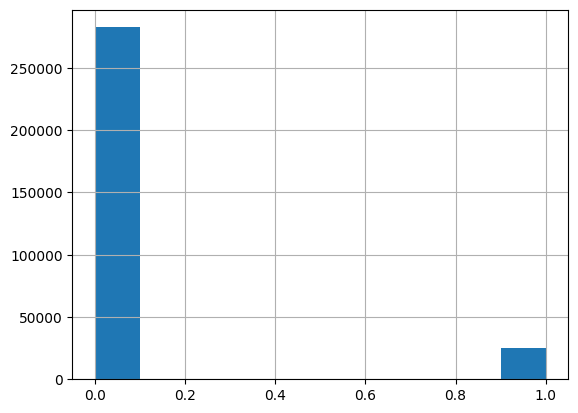

In [ ]:
df_app['TARGET'].hist()

In [ ]:
ervs = np.random.exponential(size=100)
nrvs = np.random.normal(size=100)

In [ ]:
testdf = pd.DataFrame(
    {
        "expo" : ervs,
        "norm" : nrvs
    }
)

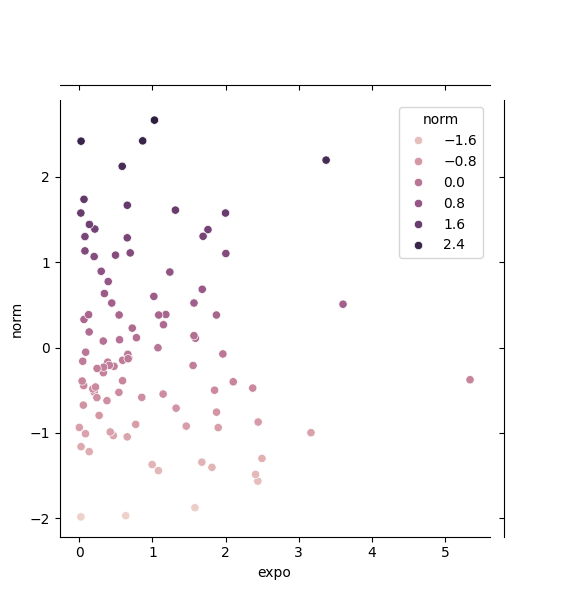

In [ ]:
sns.jointplot(testdf, x='expo', y='norm', hue='norm')

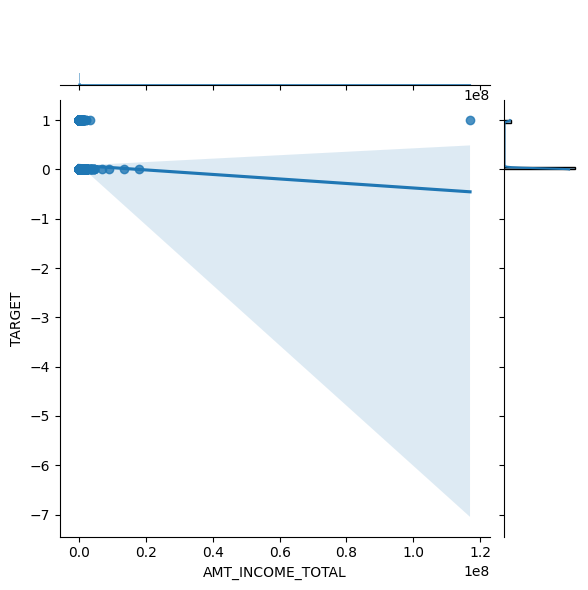

In [ ]:
i_num_col = 3

sns.jointplot(
    df_app.select_dtypes('number').iloc[:,[1,i_num_col]],
    x=df_app.select_dtypes('number').columns[i_num_col],
    y=df_app.select_dtypes('number').columns[1],
    kind='reg'
    # hue=df_app.select_dtypes('number').columns[1]
)

In [ ]:
# df_app.info(verbose=True, show_counts=True)

In [ ]:
# ! pip install -U dataprep

### DataPrep

In [ ]:
import dataprep as dp
import dataprep.eda as dpeda

Computing astype-e54912cbf716e1bc24ba3a2f8853d35e:   7%|▋         | 3106/44538 [07:11<02:10, 318.00it/s]                                         /usr/local/lib/python3.10/dist-packages/dask/core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
Computing finalize-591cf3fe-79d7-451f-8b59-6626c52f3ca1:  13%|█▎        | 5978/44538 [07:18<01:04, 596.70it/s]/usr/local/lib/python3.10/dist-packages/dataprep/eda/utils.py:392: RuntimeWarning: ks_2samp: Exact calculation unsuccessful. Switching to method=asymp.
  return cast(Tuple[float, float], ks_2samp_(data1, data2))
Computing finalize-0ff701f1-f6dc-474e-97fe-380c95755dfe:  22%|██▏       | 9902/44538 [07:25<00:58, 592.97it/s]/usr/local/lib/python3.10/dist-packages/dataprep/eda/utils.py:392: RuntimeWarning: ks_2samp: Exact calculation unsuccessful. Switching to method=asymp.
  return cast(Tuple[float, float], ks_2samp_(data1, data2))
/usr/local/lib/python3.10/dist-packages/datap

DataPrep Report
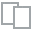
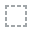
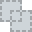
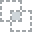
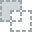
...
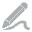
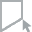
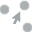
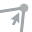
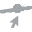

In [ ]:
dpeda.create_report(df_app)


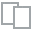
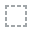
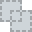
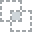
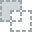
...
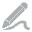
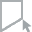
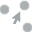
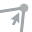
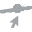

In [ ]:
dpeda.plot_correlation(df_app, 'TARGET')

## AutoML DF_APP

In [ ]:
! pip install tabpfn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 156.6/156.6 kB 1.4 MB/s eta 0:00:00


In [ ]:
# from tabpfn import TabPFNClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score

In [ ]:
import torch

In [ ]:
device = 'cuda:0' if torch.cuda.is_available() else 'cpu'

In [ ]:
tabpfn_cls = TabPFNClassifier(device=device)

In [ ]:
# X_train, X_test, y_train, y_test = train_test_split(
#     df_app.drop(columns=['TARGET']),
#     df_app['TARGET'],
#     test_size=0.33,
#     random_state=42
# )

In [ ]:
# tabpfn_cls.fit(X_train, y_train)

In [ ]:
# ! python -m ipykernel install --name "py39" --user

/usr/local/bin/python: No module named ipykernel


In [ ]:
import sys

sys.version

'3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]'

In [ ]:
# cls = autosklearn.classification.AutoSklearnClassifier()
# cls.fit(X_train, y_train)

# scores = []
# for func in [accuracy_score, roc_auc_score, f1_score]:
#     scores.append(
#         func(y_test, cls.predict(X_test))
#     )

# scores

In [ ]:
scores

[0.9200130076173395, 0.5, 0.0]

## Validation samples

In [ ]:
pvt_gb = df_app.groupby(by=["NAME_EDUCATION_TYPE", "NAME_INCOME_TYPE"])

pvt = pvt_gb[["TARGET", "AMT_CREDIT", "AMT_ANNUITY"]].agg(["count", "mean", "min", "max"])

pvt.columns = ['_'.join(pair) for pair in zip(
    pvt.columns.get_level_values(0),
    pvt.columns.get_level_values(1)
)]

pvt = pvt.reset_index()

In [ ]:
def get_pvt(df):
    pvt = df.groupby(by=["NAME_EDUCATION_TYPE", "NAME_INCOME_TYPE"])[["TARGET", "AMT_CREDIT", "AMT_ANNUITY"]].agg(["count", "mean", "min", "max"])
    pvt.columns = ['_'.join(pair) for pair in zip(
        pvt.columns.get_level_values(0),
        pvt.columns.get_level_values(1)
    )]
    return pvt.reset_index()

In [ ]:
# pvt_idx = pvt_gb.indices
# pvt_idx.keys()

# pvt_idx_df_dict = {"NAME_EDUCATION_TYPE": [], "NAME_INCOME_TYPE": [], "df_app_rows": []}
# for key_pair in pvt_idx:
#     pvt_idx_df_dict["NAME_EDUCATION_TYPE"].append(key_pair[0])
#     pvt_idx_df_dict["NAME_INCOME_TYPE"].append(key_pair[1])
#     pvt_idx_df_dict["df_app_rows"].append(pvt_idx[key_pair])

# pvt_idx_df = pd.DataFrame(pvt_idx_df_dict)

In [ ]:
df_app4strat = df_app.merge(
pvt#[
    #pvt['TARGET_count']>1]
[
    ['NAME_EDUCATION_TYPE',
     'NAME_INCOME_TYPE',
     'TARGET_mean',
     'AMT_CREDIT_mean',
     'AMT_ANNUITY_mean'
    ]
], on=['NAME_EDUCATION_TYPE', 'NAME_INCOME_TYPE']
)

<Axes: >

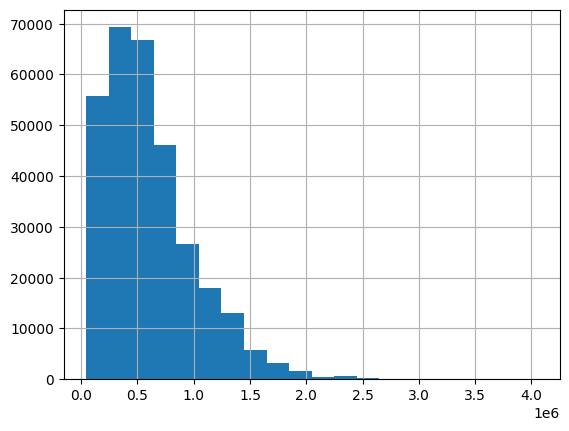

In [ ]:
df_app['AMT_CREDIT'].hist(bins=20)

<Axes: >

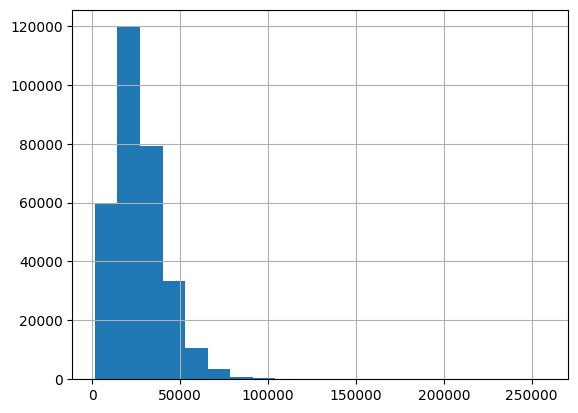

In [ ]:
df_app['AMT_ANNUITY'].hist(bins=20)

In [ ]:
from sklearn.preprocessing import KBinsDiscretizer

In [ ]:
discretizer = KBinsDiscretizer(n_bins=20, encode='ordinal', strategy='quantile')

In [ ]:
t = df_app[[ 'AMT_CREDIT', 'AMT_ANNUITY']].dropna()

df_t = pd.DataFrame(discretizer.fit_transform(t), index=t.index, columns=['binned_'+col for col in t.columns])
df_app4strat = df_app.merge(df_t, left_index=True, right_index=True)
df_app4strat

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_discretization.py:216: FutureWarning: In version 1.3 onwards, subsample=2e5 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,binned_AMT_CREDIT,binned_AMT_ANNUITY
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.0220,0.0198,0.0,0.0000,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.0000,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0,7.0,9.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.0790,0.0554,0.0,0.0000,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.0100,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,18.0,15.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [ ]:
# df_app4strat = df_app[['TARGET', 'AMT_CREDIT', 'AMT_ANNUITY']]

In [ ]:
# pvt[pvt['NAME_EDUCATION_TYPE'] == 'Academic degree']
# pvt[pvt['NAME_EDUCATION_TYPE'] == 'Higher education']
# pvt[pvt['NAME_EDUCATION_TYPE'] == 'Incomplete higher']
# pvt[pvt['NAME_EDUCATION_TYPE'] == 'Secondary / secondary special']
# pvt[pvt['NAME_EDUCATION_TYPE'] == 'Lower secondary']

NAME_EDUCATION_TYPE      NAME_INCOME_TYPE TARGET                    \
                                             count      mean min max   
0     Academic degree  Commercial associate     43  0.023256   0   1   
1     Academic degree             Pensioner     26  0.000000   0   0   
2     Academic degree         State servant     23  0.000000   0   0   
3     Academic degree               Working     72  0.027778   0   1   

  AMT_CREDIT                                    AMT_ANNUITY                \
       count          mean       min        max       count          mean   
0         43  7.831385e+05  135000.0  2250000.0          43  35682.488372   
1         26  6.167295e+05  132768.0  1354500.0          26  30108.980769   
2         23  1.022419e+06  130824.0  2463840.0          23  37568.934783   
3         72  6.309862e+05   74182.5  1800000.0          72  29822.062500   

                    
      min      max  
0  6750.0  92727.0  
1  6777.0  69295.5  
2  6097.5  74830.5  
3  6363.0  74286.0

In [140]:
from sklearn.model_selection import StratifiedShuffleSplit

In [ ]:
df_app4strat  = df_app4strat.dropna()

In [ ]:
# df_app4strat = df_app4strat.merge(
#     df_app4strat[['AMT_ANNUITY_mean', 'AMT_CREDIT_mean', 'TARGET_mean']].value_counts().to_frame().reset_index(),
#     on=['AMT_ANNUITY_mean', 'AMT_CREDIT_mean', 'TARGET_mean']
# )
# df_app4strat = df_app4strat[df_app4strat['count']>1]

In [ ]:
sss = StratifiedShuffleSplit(n_splits=1, test_size=0.001, random_state=42)

In [ ]:
t = df_app4strat[['binned_AMT_ANNUITY', 'binned_AMT_CREDIT', 'TARGET']].value_counts().to_frame().reset_index()
t

,binned_AMT_ANNUITY,binned_AMT_CREDIT,TARGET,count
0,1.0,2.0,0,8892
1,3.0,5.0,0,6928
2,19.0,19.0,0,6294
3,0.0,0.0,0,6167
4,2.0,3.0,0,5124
...,...,...,...,...
539,9.0,17.0,1,1
540,1.0,9.0,0,1
541,14.0,19.0,1,1
542,12.0,18.0,1,1


In [ ]:
t = df_app[[
    'AMT_CREDIT',
    #'AMT_ANNUITY'
]].dropna()

df_t = pd.DataFrame(discretizer.fit_transform(t), index=t.index, columns=['binned_'+col for col in t.columns])
df_app4strat = df_app.merge(df_t, left_index=True, right_index=True)

t = df_app4strat[[
    #'binned_AMT_ANNUITY',
    'binned_AMT_CREDIT', 'TARGET']].value_counts().to_frame().reset_index()
temp = df_app4strat.merge(
    t,
    on=[
        #'binned_AMT_ANNUITY',
        'binned_AMT_CREDIT', 'TARGET']
)
df_app4strat = temp[temp['count'] > 1]


/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_discretization.py:216: FutureWarning: In version 1.3 onwards, subsample=2e5 will be used by default. Set subsample explicitly to silence this warning in the mean time. Set subsample=None to disable subsampling explicitly.
  warnings.warn(


In [ ]:
# train_index, test_index = next(sss.split(df_app4strat, df_app4strat[['AMT_ANNUITY_mean', 'AMT_CREDIT_mean', 'TARGET_mean']]))

train_index, test_index = next(sss.split(df_app4strat, df_app4strat[[
    #'binned_AMT_ANNUITY',
    'binned_AMT_CREDIT',
    'TARGET'
]]))

In [ ]:
df_app_train = df_app.iloc[train_index]

In [ ]:
df_app_val = df_app.iloc[test_index]

In [ ]:
get_pvt(df_app_train)

,NAME_EDUCATION_TYPE,NAME_INCOME_TYPE,TARGET_count,TARGET_mean,TARGET_min,TARGET_max,AMT_CREDIT_count,AMT_CREDIT_mean,AMT_CREDIT_min,AMT_CREDIT_max,AMT_ANNUITY_count,AMT_ANNUITY_mean,AMT_ANNUITY_min,AMT_ANNUITY_max
0,Academic degree,Commercial associate,43,0.023256,0,1,43,7.831385e+05,135000.0,2250000.0,43,35682.488372,6750.0,92727.0
1,Academic degree,Pensioner,26,0.000000,0,0,26,6.167295e+05,132768.0,1354500.0,26,30108.980769,6777.0,69295.5
2,Academic degree,State servant,23,0.000000,0,0,23,1.022419e+06,130824.0,2463840.0,23,37568.934783,6097.5,74830.5
3,Academic degree,Working,72,0.027778,0,1,72,6.309862e+05,74182.5,1800000.0,72,29822.062500,6363.0,74286.0
4,Higher education,Businessman,10,0.000000,0,0,10,1.228500e+06,225000.0,2250000.0,10,72675.000000,11250.0,225000.0
5,Higher education,Commercial associate,24008,0.051733,0,1,24008,7.485953e+05,45000.0,4050000.0,24006,33518.479068,2425.5,258025.5
6,Higher education,Maternity leave,3,0.000000,0,0,3,6.300000e+05,315000.0,810000.0,3,44250.000000,15750.0,76500.0
7,Higher education,Pensioner,8175,0.041590,0,1,8175,6.385631e+05,45000.0,3312162.0,8175,28216.904037,1993.5,225000.0
8,Higher education,State servant,8847,0.038883,0,1,8847,7.334178e+05,45000.0,3600000.0,8846,31402.543918,3006.0,225000.0
9,Higher education,Student,6,0.000000,0,0,6,4.662900e+05,95940.0,675000.0,6,22159.500000,10332.0,30690.0


In [ ]:
get_pvt(df_app_val)

,NAME_EDUCATION_TYPE,NAME_INCOME_TYPE,TARGET_count,TARGET_mean,TARGET_min,TARGET_max,AMT_CREDIT_count,AMT_CREDIT_mean,AMT_CREDIT_min,AMT_CREDIT_max,AMT_ANNUITY_count,AMT_ANNUITY_mean,AMT_ANNUITY_min,AMT_ANNUITY_max
0,Higher education,Commercial associate,17,0.058824,0,1,17,769725.000000,80865.0,2254500.0,17,29786.558824,6610.5,56992.5
1,Higher education,Pensioner,13,0.000000,0,0,13,623653.269231,81000.0,1546020.0,13,26323.269231,3532.5,42642.0
2,Higher education,State servant,16,0.000000,0,0,16,536067.000000,172512.0,1800000.0,16,22816.125000,9000.0,50400.0
3,Higher education,Working,30,0.000000,0,0,30,602923.650000,86598.0,1800000.0,30,25953.900000,6750.0,70564.5
4,Incomplete higher,Commercial associate,2,0.000000,0,0,2,694773.000000,143910.0,1245636.0,2,27765.000000,14233.5,41296.5
5,Incomplete higher,Pensioner,1,0.000000,0,0,1,405000.000000,405000.0,405000.0,1,20250.000000,20250.0,20250.0
6,Incomplete higher,State servant,2,0.000000,0,0,2,488232.000000,301464.0,675000.0,2,25998.750000,19395.0,32602.5
7,Incomplete higher,Working,5,0.000000,0,0,5,385128.000000,180000.0,585000.0,5,19353.600000,9000.0,29250.0
8,Lower secondary,Working,2,0.000000,0,0,2,908277.750000,396850.5,1419705.0,2,46471.500000,19431.0,73512.0
9,Secondary / secondary special,Commercial associate,51,0.078431,0,1,51,653683.235294,135000.0,2013840.0,51,28968.794118,4369.5,62698.5


In [ ]:
df_app_val.shape[0]

308

In [ ]:
df_app_val

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
237427,375011,0,Cash loans,F,N,Y,0,202500.0,1288350.0,37800.0,1125000.0,Unaccompanied,Pensioner,Secondary / secondary special,Married,House / apartment,0.005002,-20630,365243,-5912.0,-4163,NaN,1,0,0,1,0,0,NaN,2.0,3,3,TUESDAY,17,0,0,0,0,0,0,XNA,NaN,0.429493,0.196334,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,1.0,4.0,1.0,-1611.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
284232,429168,0,Cash loans,F,N,Y,1,90000.0,206280.0,7906.5,135000.0,Unaccompanied,Working,Secondary / secondary special,Separated,House / apartment,0.030755,-13248,-4496,-4767.0,-4783,NaN,1,1,0,1,0,0,Core staff,2.0,2,2,SATURDAY,12,0,0,0,0,0,0,Kindergarten,0.415423,0.636436,0.269286,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-300.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,2.0
163322,289342,1,Cash loans,F,N,Y,1,238500.0,402948.0,42444.0,378000.0,Family,Working,Secondary / secondary special,Separated,House / apartment,0.018634,-18302,-3931,-5845.0,-1861,NaN,1,1,0,1,0,0,Core staff,2.0,2,2,MONDAY,10,0,0,0,0,1,1,Postal,0.383252,0.630592,0.191822,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,2.0,4.0,0.0,-2005.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,5.0
1270,101498,0,Cash loans,M,N,N,2,236799.0,1350000.0,37255.5,1350000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.035792,-11697,-

In [ ]:
df_app_val4save = df_app_val.reset_index()
df_app_val4save.to_csv("df_app_val_binned.csv")#.drop(columns=[df_app_val4save.columns[0]])
#

In [ ]:
df_app_val_loaded = pd.read_csv("df_app_val.csv", index_col="index")
df_app_val_loaded = df_app_val_loaded.drop(columns=df_app_val_loaded.columns[0])
df_app_val_loaded

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
206876,339785,0,Cash loans,F,N,Y,0,67500.0,365175.0,13896.0,301500.0,Unaccompanied,State servant,Secondary / secondary special,Single / not married,With parents,0.031329,-14679,-2985,-2246.0,-4511,NaN,1,1,0,1,1,0,Waiters/barmen staff,1.0,2,2,MONDAY,10,0,0,0,0,0,0,Medicine,NaN,0.205009,0.669057,0.0619,0.0524,0.9881,0.8300,NaN,0.0000,0.1552,0.1667,NaN,0.0361,0.0504,0.0613,0.0000,0.0356,0.0630,0.0280,0.9876,0.8367,NaN,0.0000,0.1034,0.1667,NaN,0.0146,0.0551,0.0638,0.0000,0.0000,0.0625,0.0524,0.9881,0.8323,NaN,0.0,0.1552,0.1667,NaN,0.0367,0.0513,0.0624,0.0000,0.0363,org spec account,block of flats,0.0483,Panel,No,3.0,0.0,3.0,0.0,-156.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,2.0
2659,103105,1,Cash loans,M,Y,N,0,54000.0,436032.0,16564.5,360000.0,Family,Pensioner,Secondary / secondary special,Married,Municipal apartment,0.031329,-22668,365243,-4370.0,-4742,24.0,1,0,0,1,0,0,NaN,2.0,2,2,THURSDAY,7,0,0,0,0,0,0,XNA,NaN,0.162192,0.638044,0.0719,0.0713,0.9851,0.7960,0.0343,0.0112,0.1379,0.1904,0.2321,0.0721,0.0583,0.0717,0.0011,0.0017,0.0630,0.0479,0.9772,0.6994,0.0252,0.0000,0.1379,0.1667,0.2083,0.0292,0.0551,0.0537,0.0000,0.0000,0.0739,0.0700,0.9871,0.8256,0.0347,0.0,0.1379,0.1667,0.2083,0.0661,0.0607,0.0794,0.0000,0.0000,reg oper account,block of flats,0.0552,Panel,No,3.0,0.0,3.0,0.0,-2163.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,3.0
45654,152886,0,Cash loans,F,N,Y,0,72000.0,269550.0,11547.0,225000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.006008,-20463,-1820,-4442.0,-4018,NaN,1,1,0,1,0,0,Accountants,2.0,2,2,TUESDAY,17,0,0,0,0,0,0,Business Entity Type 3,0.856676,0.681362,0.424130,0.294

In [ ]:
sum([idx in df_app_val.index for idx in df_app_val_loaded.index])

0

In [ ]:
gdown.download(id='1quQcdv83jMNIV1Ice3Kk_SEkRPLeTQOE')

Downloading...
From: https://drive.google.com/uc?id=1quQcdv83jMNIV1Ice3Kk_SEkRPLeTQOE
To: /content/df_app_val.csv
100%|██████████| 168k/168k [00:00<00:00, 35.4MB/s]


'df_app_val.csv'

In [77]:
gdown.download(id='1qkEJZx5y00mbXLyL25WxU8T4XBxDVyyx')

Downloading...
From: https://drive.google.com/uc?id=1qkEJZx5y00mbXLyL25WxU8T4XBxDVyyx
To: /content/df_app_val_binned.csv
100%|██████████| 169k/169k [00:00<00:00, 36.4MB/s]


'df_app_val_binned.csv'

In [78]:
df_app_val_loaded = pd.read_csv("df_app_val_binned.csv", index_col="index")
df_app_val = df_app_val_loaded.drop(columns=df_app_val_loaded.columns[0])
df_app_val

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
237427,375011,0,Cash loans,F,N,Y,0,202500.0,1288350.0,37800.0,1125000.0,Unaccompanied,Pensioner,Secondary / secondary special,Married,House / apartment,0.005002,-20630,365243,-5912.0,-4163,NaN,1,0,0,1,0,0,NaN,2.0,3,3,TUESDAY,17,0,0,0,0,0,0,XNA,NaN,0.429493,0.196334,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5.0,1.0,4.0,1.0,-1611.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
284232,429168,0,Cash loans,F,N,Y,1,90000.0,206280.0,7906.5,135000.0,Unaccompanied,Working,Secondary / secondary special,Separated,House / apartment,0.030755,-13248,-4496,-4767.0,-4783,NaN,1,1,0,1,0,0,Core staff,2.0,2,2,SATURDAY,12,0,0,0,0,0,0,Kindergarten,0.415423,0.636436,0.269286,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-300.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,2.0
163322,289342,1,Cash loans,F,N,Y,1,238500.0,402948.0,42444.0,378000.0,Family,Working,Secondary / secondary special,Separated,House / apartment,0.018634,-18302,-3931,-5845.0,-1861,NaN,1,1,0,1,0,0,Core staff,2.0,2,2,MONDAY,10,0,0,0,0,1,1,Postal,0.383252,0.630592,0.191822,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0,2.0,4.0,0.0,-2005.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,1.0,0.0,5.0
1270,101498,0,Cash loans

## Manual preprocessing

In [79]:
df_app_orig = df_app
df_app.shape

(307511, 122)

In [80]:
df_app = df_app.iloc[~df_app.index.isin(df_app_val.index)]

In [81]:
df = df_app.drop_duplicates()

In [ ]:
df.shape

(307511, 122)

<Axes: >

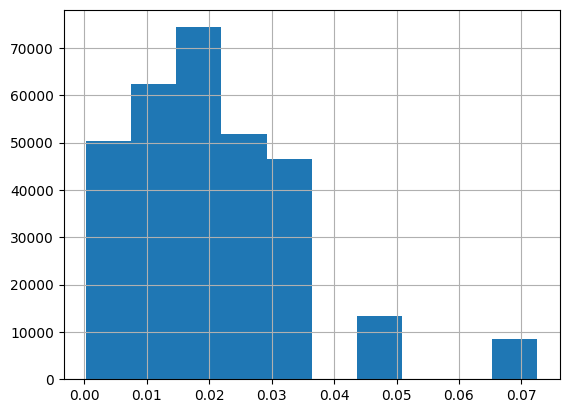

In [ ]:
df["REGION_POPULATION_RELATIVE"].hist()

### NaNs

In [ ]:
t = df.isna().sum().to_frame().reset_index()
t.columns=["col", "nan_count"]

t["nan%"] = t["nan_count"] / df.shape[0]
t[t["nan%"] > 0.4]["col"]

21                     OWN_CAR_AGE
41                    EXT_SOURCE_1
44                  APARTMENTS_AVG
45                BASEMENTAREA_AVG
46     YEARS_BEGINEXPLUATATION_AVG
47                 YEARS_BUILD_AVG
48                  COMMONAREA_AVG
49                   ELEVATORS_AVG
50                   ENTRANCES_AVG
51                   FLOORSMAX_AVG
52                   FLOORSMIN_AVG
53                    LANDAREA_AVG
54            LIVINGAPARTMENTS_AVG
55                  LIVINGAREA_AVG
56         NONLIVINGAPARTMENTS_AVG
57               NONLIVINGAREA_AVG
58                 APARTMENTS_MODE
59               BASEMENTAREA_MODE
60    YEARS_BEGINEXPLUATATION_MODE
61                YEARS_BUILD_MODE
62                 COMMONAREA_MODE
63                  ELEVATORS_MODE
64                  ENTRANCES_MODE
65                  FLOORSMAX_MODE
66                  FLOORSMIN_MODE
67                   LANDAREA_MODE
68           LIVINGAPARTMENTS_MODE
69                 LIVINGAREA_MODE
70        NONLIVINGA

In [ ]:
set(t[t["nan%"] > 0]["col"]).difference(set(t[t["nan%"] > 0.4]["col"]))

{'AMT_ANNUITY',
 'AMT_GOODS_PRICE',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'AMT_REQ_CREDIT_BUREAU_YEAR',
 'CNT_FAM_MEMBERS',
 'DAYS_LAST_PHONE_CHANGE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'NAME_TYPE_SUITE',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'OCCUPATION_TYPE'}

In [ ]:
label = df["TARGET"]

### Numerical

In [ ]:
df.select_dtypes("number")

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,0,202500.0,406597.5,24700.5,351000.0,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,1.0,2,2,10,0,0,0,0,0,0,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.0220,0.0198,0.0,0.0000,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.0000,0.0149,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,0,270000.0,1293502.5,35698.5,1129500.0,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,2.0,1,1,11,0,0,0,0,0,0,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.0790,0.0554,0.0,0.0000,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.0100,0.0714,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,0,67500.0,135000.0,6750.0,135000.0,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,1.0,2,2,9,0,0,0,0,0,0,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-815.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,0,135000.0,312682.5,29686.5,297000.0,0.008019,-19005,-3039,-9833.0,-2437,NaN,1,1,0,1,0,0,2.0,2,2,17,0,0,0,0,0,0,NaN,0.650442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.0,0.0,2.0,0.0,-617.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,0,121500.0,513000.0,21865.5,513000.0,0.028663,-19932,-3038,-4311.0,-3458,NaN,1,1,0,1,0,0,1.0,2,2,11,0,0,0,0,1,1,NaN,0.322738,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [82]:
df_num = df.select_dtypes("number")

In [83]:
from sklearn.impute import SimpleImputer

In [84]:
imp_num = SimpleImputer(strategy="median")

In [ ]:
df_num.columns

Index(['SK_ID_CURR', 'TARGET', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH', 'DAYS_EMPLOYED',
       ...
       'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20',
       'FLAG_DOCUMENT_21', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object', length=106)

In [85]:
df_num = pd.DataFrame(
    imp_num.fit_transform(df.select_dtypes("number"))
)
df_num.columns = df.select_dtypes("number").columns
df_num = df_num.drop(columns=['SK_ID_CURR'])

In [86]:
minmax_cols = list(set(df_num.columns).difference(set(normal_cols)))

In [87]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [88]:
standard_scaler = StandardScaler()
minmax_scaler = MinMaxScaler()

In [89]:
num_normal_cols = list(set(normal_cols).intersection(set(df_num.columns)))

In [90]:
df_num[num_normal_cols] = standard_scaler.fit_transform(df_num[num_normal_cols])
df_num[minmax_cols] = minmax_scaler.fit_transform(df_num[minmax_cols])

In [ ]:
df_num

,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,1.0,0.0,0.001512,0.090287,0.090032,0.077441,0.256321,0.888839,0.045086,0.852140,0.705433,0.098901,1.0,1.0,0.0,1.0,1.0,0.0,0.000000,0.5,0.5,0.434783,0.0,0.0,0.0,0.0,0.0,0.0,-3.022201,-1.317901,-2.153807,-1.002453,-0.831562,-0.174747,-2.059453,-0.322276,-0.368529,-1.056865,-1.061548,-0.986205,-0.354318,-1.187456,-0.901560,-0.100846,-0.305233,-0.954053,-0.762077,-0.152829,-2.021966,-0.276840,-0.356000,-1.017854,-1.054464,-0.976157,-0.299949,-1.132664,-0.864234,-0.095484,-0.260790,-0.983991,-0.824854,-0.172994,-2.053863,-0.314256,-0.365361,-1.050254,-1.057389,-0.982099,-0.350697,-1.180757,-0.893799,-0.099728,-0.295522,-0.902010,0.005747,0.058824,0.005814,0.083333,0.735788,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.000000,0.0,0.04
1,0.0,0.0,0.002089,0.311736,0.132924,0.271605,0.045016,0.477114,0.043648,0.951929,0.959566,0.098901,1.0,1.0,0.0,1.0,1.0,0.0,0.052632,0.0,0.0,0.478261,0.0,0.0,0.0,0.0,0.0,0.0,-1.385078,0.564545,0.111969,-0.082609,-0.532143,0.129144,0.636033,0.750377,0.431215,-1.544527,0.890458,1.274057,-0.809470,-0.117384,-0.451296,0.045157,-0.101763,-0.084005,-0.478605,0.125830,0.641740,0.559117,0.468873,-1.502087,0.919205,1.291776,-0.770234,-0.125926,-0.422642,-0.095484,-0.260790,-0.065099,-0.524505,0.127488,0.633799,0.760814,0.436284,-1.536520,0.890303,1.270893,-0.807849,-0.103280,-0.443098,0.047289,-0.089884,-0.187801,0.002874,0.000000,0.002907,0.000000,0.807083,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.000000,0.0,0.00
2,0.0,0.0,0.000358,0.022472,0.020025,0.023569,0.134897,0.348534,0.046161,0.827335,0.648326,0.285714,1.0,1.0,1.0,1.0,1.0,0.0,0.000000,0.5,0.5,0.391304,0.0,0.0,0.0,0.0,0.0,0.0,0.012269,0.217006,1.223911,-0.189838,-0.094244,0.046693,0.013998,-0.164397,-0.368529,-0.082953,-0.280371,-0.082317,-0.141025,-0.149242,-0.205469,-0.100846,-0.230489,-0.192761,-0.098204,0.050225,0.027159,-0.167905,-0.356000,-0.050792,-0.264618,-0.069202,-0.146965,-0.159484,-0.203087,-0.095484,-0.238243,-0.198198,-0.094631,0.045962,0.014281,-0.165971,-0.365361,

### Categorical

In [91]:
imp_cat = SimpleImputer(strategy="most_frequent")

In [92]:
df_cat = pd.DataFrame(
    imp_cat.fit_transform(df.select_dtypes("object"))
)
df_cat.columns = df.select_dtypes("object").columns

In [93]:
df_cat = df_cat.drop(columns=['FONDKAPREMONT_MODE', 'HOUSETYPE_MODE', 'EMERGENCYSTATE_MODE'])

In [94]:
ohe_cols = [
    'NAME_CONTRACT_TYPE',
    'CODE_GENDER',
    'WALLSMATERIAL_MODE'
]
ord_cols = list(filter(lambda x: x not in ohe_cols, df_cat.columns))

In [ ]:
df_cat

,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,WEEKDAY_APPR_PROCESS_START,ORGANIZATION_TYPE,WALLSMATERIAL_MODE
0,Cash loans,M,N,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,WEDNESDAY,Business Entity Type 3,"Stone, brick"
1,Cash loans,F,N,N,Family,State servant,Higher education,Married,House / apartment,Core staff,MONDAY,School,Block
2,Revolving loans,M,Y,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Laborers,MONDAY,Government,Panel
3,Cash loans,F,N,Y,Unaccompanied,Working,Secondary / secondary special,Civil marriage,House / apartment,Laborers,WEDNESDAY,Business Entity Type 3,Panel
4,Cash loans,M,N,Y,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,Core staff,THURSDAY,Religion,Panel
...,...,...,...,...,...,...,...,...,...,...,...,...,...
307506,Cash loans,M,N,N,Unaccompanied,Working,Secondary / secondary special,Separated,With parents,Sales staff,THURSDAY,Services,"Stone, brick"
307507,Cash loans,F,N,Y,Unaccompanied,Pensioner,Secondary / secondary special,Widow,House / apartment,Laborers,MONDAY,XNA,"Stone, brick"
307508,Cash loans,F,N,Y,Unaccompanied,Working,Higher education,Separated,House / apartment,Managers,THURSDAY,School,Panel
307509,Cash loans,F,N,Y,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,Laborers,WEDNESDAY,Business Entity Type 1,"Stone, brick"


In [95]:
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder

In [96]:
ord_enc = OrdinalEncoder()
ohe_enc = OneHotEncoder()#categories=ohe_cols)

In [97]:
df_cat_ohe = pd.pandas.get_dummies(df_cat[ohe_cols], dtype=float)
df_cat_ohe

,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden
0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
307198,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
307199,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
307200,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
307201,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


In [98]:
df_cat_ord = pd.DataFrame(ord_enc.fit_transform(df_cat[ord_cols]))
df_cat_ord.columns = df_cat[ord_cols].columns

df_cat_rdy = df_cat_ord.merge(df_cat_ohe, left_index=True, right_index=True)

In [99]:
df_cat_rdy

,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,WEEKDAY_APPR_PROCESS_START,ORGANIZATION_TYPE,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden
0,0.0,1.0,6.0,7.0,4.0,3.0,1.0,8.0,6.0,5.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,1.0,4.0,1.0,1.0,1.0,3.0,1.0,39.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1.0,1.0,6.0,7.0,4.0,3.0,1.0,8.0,1.0,11.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.0,1.0,6.0,7.0,4.0,0.0,1.0,8.0,6.0,5.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.0,1.0,6.0,7.0,4.0,3.0,1.0,3.0,4.0,37.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
307198,0.0,0.0,6.0,7.0,4.0,2.0,5.0,14.0,4.0,43.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
307199,0.0,1.0,6.0,3.0,4.0,5.0,1.0,8.0,1.0,57.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
307200,0.0,1.0,6.0,7.0,1.0,2.0,1.0,10.0,4.0,39.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
307201,0.0,1.0,6.0,1.0,4.0,1.0,1.0,8.0,6.0,3.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0


### Correlations

### Information value

In [100]:
def calc_iv(df, target ,feature):

    lst = []
    print(df[feature].unique())

    for val in df[feature].unique():
        all_f = df[df[feature] == val].count()[feature]
        bad_f = df[(df[feature] == val) & (df[target] == 1)].count()[feature]
        lst.append([feature, val, all_f, bad_f])

    data = pd.DataFrame(lst, columns=['Variable', 'Value', 'All', 'Bad'])
    data = data[data['Bad'] > 0]

    data['Share'] = data['All'] / data['All'].sum()
    data['Bad Rate'] = data['Bad'] / data['All']
    data['Distribution Good'] = (data['All'] - data['Bad']) / (data['All'].sum() - data['Bad'].sum())
    data['Distribution Bad'] = data['Bad'] / data['Bad'].sum()
    data['WoE'] = np.log(data['Distribution Good'] / data['Distribution Bad'])
    data['IV'] = (data['WoE'] * (data['Distribution Good'] - data['Distribution Bad'])).sum()

    data = data.sort_values(by=['Variable', 'Value'], ascending=True)

    return data

In [ ]:
list(filter(lambda x: x[:4]=='FLAG', df_num.columns))

['FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_WORK_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_4',
 'FLAG_DOCUMENT_5',
 'FLAG_DOCUMENT_6',
 'FLAG_DOCUMENT_7',
 'FLAG_DOCUMENT_8',
 'FLAG_DOCUMENT_9',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT_14',
 'FLAG_DOCUMENT_15',
 'FLAG_DOCUMENT_16',
 'FLAG_DOCUMENT_17',
 'FLAG_DOCUMENT_18',
 'FLAG_DOCUMENT_19',
 'FLAG_DOCUMENT_20',
 'FLAG_DOCUMENT_21']

In [ ]:
df_cat.columns.to_list()

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE',
 'WALLSMATERIAL_MODE']

In [101]:
df_cat_wt = df_cat.merge(df_num, left_index=True, right_index=True)

In [ ]:
dft = calc_iv(df_cat_wt, 'TARGET', 'NAME_INCOME_TYPE')
dft.loc[dft.index[np.argmin(dft['WoE'])]]
dft

['Working' 'State servant' 'Commercial associate' 'Pensioner' 'Unemployed'
 'Student' 'Businessman' 'Maternity leave']


,Variable,Value,All,Bad,Share,Bad Rate,Distribution Good,Distribution Bad,WoE,IV
2,NAME_INCOME_TYPE,Commercial associate,71617,5360,0.232914,0.074843,0.234407,0.215911,0.082191,0.058325
7,NAME_INCOME_TYPE,Maternity leave,5,2,0.000016,0.400000,0.000011,0.000081,-2.026921,0.058325
3,NAME_INCOME_TYPE,Pensioner,55362,2982,0.180049,0.053864,0.185312,0.120121,0.433544,0.058325
1,NAME_INCOME_TYPE,State servant,21703,1249,0.070583,0.057550,0.072363,0.050312,0.363449,0.058325
4,NAME_INCOME_TYPE,Unemployed,22,8,0.000072,0.363636,0.000050,0.000322,-1.872771,0.058325
0,NAME_INCOME_TYPE,Working,158774,15224,0.516367,0.095885,0.507858,0.613253,-0.188576,0.058325


In [ ]:
calc_iv(df_cat_wt, 'TARGET', 'NAME_EDUCATION_TYPE')

['Secondary / secondary special' 'Higher education' 'Incomplete higher'
 'Lower secondary' 'Academic degree']


,Variable,Value,All,Bad,Share,Bad Rate,Distribution Good,Distribution Bad,WoE,IV
4,NAME_EDUCATION_TYPE,Academic degree,164,3,0.000533,0.018293,0.000570,0.000121,1.550307,0.050836
1,NAME_EDUCATION_TYPE,Higher education,74863,4009,0.243448,0.053551,0.250646,0.161490,0.439594,0.050836
2,NAME_EDUCATION_TYPE,Incomplete higher,10277,872,0.033420,0.084850,0.033270,0.035126,-0.054278,0.050836
3,NAME_EDUCATION_TYPE,Lower secondary,3816,417,0.012409,0.109277,0.012024,0.016798,-0.334335,0.050836
0,NAME_EDUCATION_TYPE,Secondary / secondary special,218391,19524,0.710189,0.089399,0.703491,0.786465,-0.111494,0.050836


In [ ]:
calc_iv(df_cat_wt, 'TARGET', 'OCCUPATION_TYPE')

['Laborers' 'Core staff' 'Accountants' 'Managers' 'Drivers' 'Sales staff'
 'Cleaning staff' 'Cooking staff' 'Private service staff' 'Medicine staff'
 'Security staff' 'High skill tech staff' 'Waiters/barmen staff'
 'Low-skill Laborers' 'Realty agents' 'Secretaries' 'IT staff' 'HR staff']


,Variable,Value,All,Bad,Share,Bad Rate,Distribution Good,Distribution Bad,WoE,IV
2,OCCUPATION_TYPE,Accountants,9813,474,0.031911,0.048303,0.033037,0.019094,0.548262,0.049611
6,OCCUPATION_TYPE,Cleaning staff,4653,447,0.015131,0.096067,0.014879,0.018006,-0.190777,0.049611
7,OCCUPATION_TYPE,Cooking staff,5946,621,0.019336,0.104440,0.018837,0.025015,-0.283649,0.049611
1,OCCUPATION_TYPE,Core staff,27570,1738,0.089655,0.063040,0.091381,0.070010,0.266393,0.049611
4,OCCUPATION_TYPE,Drivers,18603,2107,0.060495,0.113261,0.058354,0.084874,-0.374633,0.049611
17,OCCUPATION_TYPE,HR staff,563,36,0.001831,0.063943,0.001864,0.001450,0.251196,0.049611
11,OCCUPATION_TYPE,High skill tech staff,11380,701,0.037007,0.061599,0.037777,0.028238,0.291041,0.049611
16,OCCUPATION_TYPE,IT staff,526,34,0.001711,0.064639,0.001740,0.001370,0.239633,0.049611
0,OCCUPATION_TYPE,Laborers,151577,12116,0.492916,0.079933,0.493342,0.488056,0.010773,0.049611
13,OCCUPATION_TYPE,Low-skill Laborers,2093,359,0.006806,0.171524,0.006134,0.014461,-0.857622,0.049611


In [102]:
def make_mapper(df):
    df_dict = df.to_dict('list')
    return {val:df_dict['WoE'][i] for i, val in enumerate(df_dict['Value'])}

In [ ]:
name_type_suite2woe = make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_TYPE_SUITE')[['Value', 'WoE']])
name_income_type2woe = make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_INCOME_TYPE')[['Value', 'WoE']])
name_education_type2woe = make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_EDUCATION_TYPE')[['Value', 'WoE']])
name_family_status2woe = make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_FAMILY_STATUS')[['Value', 'WoE']])
name_housing_type2woe = make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_HOUSING_TYPE')[['Value', 'WoE']])
occupation_type2woe = make_mapper(calc_iv(df_cat_wt, 'TARGET', 'OCCUPATION_TYPE')[['Value', 'WoE']])
organization_type2woe = make_mapper(calc_iv(df_cat_wt, 'TARGET', 'ORGANIZATION_TYPE')[['Value', 'WoE']])

In [103]:
cols2woe = {
    'NAME_TYPE_SUITE': make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_TYPE_SUITE')[['Value', 'WoE']]),
    'NAME_INCOME_TYPE': make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_INCOME_TYPE')[['Value', 'WoE']]),
    'NAME_EDUCATION_TYPE': make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_EDUCATION_TYPE')[['Value', 'WoE']]),
    'NAME_FAMILY_STATUS': make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_FAMILY_STATUS')[['Value', 'WoE']]),
    'NAME_HOUSING_TYPE': make_mapper(calc_iv(df_cat_wt, 'TARGET', 'NAME_HOUSING_TYPE')[['Value', 'WoE']]),
    'OCCUPATION_TYPE': make_mapper(calc_iv(df_cat_wt, 'TARGET', 'OCCUPATION_TYPE')[['Value', 'WoE']]),
    'ORGANIZATION_TYPE':make_mapper(calc_iv(df_cat_wt, 'TARGET', 'ORGANIZATION_TYPE')[['Value', 'WoE']]),
}

['Unaccompanied' 'Family' 'Spouse, partner' 'Children' 'Other_A' 'Other_B'
 'Group of people']
['Working' 'State servant' 'Commercial associate' 'Pensioner' 'Unemployed'
 'Student' 'Businessman' 'Maternity leave']
['Secondary / secondary special' 'Higher education' 'Incomplete higher'
 'Lower secondary' 'Academic degree']
['Single / not married' 'Married' 'Civil marriage' 'Widow' 'Separated'
 'Unknown']
['House / apartment' 'Rented apartment' 'With parents'
 'Municipal apartment' 'Office apartment' 'Co-op apartment']
['Laborers' 'Core staff' 'Accountants' 'Managers' 'Drivers' 'Sales staff'
 'Cleaning staff' 'Cooking staff' 'Private service staff' 'Medicine staff'
 'Security staff' 'High skill tech staff' 'Waiters/barmen staff'
 'Low-skill Laborers' 'Realty agents' 'Secretaries' 'IT staff' 'HR staff']
['Business Entity Type 3' 'School' 'Government' 'Religion' 'Other' 'XNA'
 'Electricity' 'Medicine' 'Business Entity Type 2' 'Self-employed'
 'Transport: type 2' 'Construction' 'Housing' 'K

In [104]:
cols_filtered_by_IV = [
    'FLAG_MOBIL',
    #'FLAG_WORK_PHONE',
    'FLAG_CONT_MOBILE',
    'FLAG_PHONE',
    'FLAG_EMAIL',
    'FLAG_DOCUMENT_2',
    'FLAG_DOCUMENT_4',
    'FLAG_DOCUMENT_5',
    #'FLAG_DOCUMENT_6',
    'FLAG_DOCUMENT_7',
    'FLAG_DOCUMENT_8',
    'FLAG_DOCUMENT_9',
    'FLAG_DOCUMENT_10',
    'FLAG_DOCUMENT_11',
    'FLAG_DOCUMENT_12',
    'FLAG_DOCUMENT_13',
    'FLAG_DOCUMENT_14',
    'FLAG_DOCUMENT_15',
    'FLAG_DOCUMENT_16',
    'FLAG_DOCUMENT_17',
    'FLAG_DOCUMENT_18',
    'FLAG_DOCUMENT_19',
    'FLAG_DOCUMENT_20',
    'FLAG_DOCUMENT_21',
    'WEEKDAY_APPR_PROCESS_START',
]

## Models

In [105]:
df_ds_1 = df_num.merge(df_cat_rdy, left_index=True, right_index=True)

In [106]:
df_ds_1 = df_ds_1.drop(columns=cols_filtered_by_IV)

In [107]:
def woe_crutch_mapper(col, x, mode):
    if x not in cols2woe[col]:
        # print(col, x)
        return cols2woe[col][mode]
    return cols2woe[col][x]

In [108]:


for col in cols2woe:
    df_ds_1[col] = df_cat_wt[col]
    mode = df_ds_1[col].mode().values[0]
    try:
        df_ds_1[col] = df_ds_1[col].apply(lambda x: woe_crutch_mapper(col, x, mode))
    except (KeyError):
        print(col)
        break

In [109]:
df_ds_1[cols2woe.keys()]

,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,ORGANIZATION_TYPE
0,-0.012846,-0.188660,-0.111430,-0.214190,0.038035,0.010581,-0.155170
1,0.080743,0.362998,0.439392,0.071274,0.038035,0.267451,0.335459
2,-0.012846,-0.188660,-0.111430,-0.214190,0.038035,0.010581,0.157253
3,-0.012846,-0.188660,-0.111430,-0.229106,0.038035,0.010581,-0.155170
4,-0.012846,-0.188660,-0.111430,-0.214190,0.038035,0.267451,0.340711
...,...,...,...,...,...,...,...
307198,-0.012846,-0.188660,-0.111430,-0.015162,-0.411918,-0.193973,0.216069
307199,-0.012846,0.433399,-0.111430,0.350476,0.038035,0.010581,0.430696
307200,-0.012846,-0.188660,0.439392,-0.015162,0.038035,0.281530,0.335459
307201,-0.012846,0.082751,-0.111430,0.071274,0.038035,0.010581,-0.008912


In [ ]:
df_ds_1

,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,ORGANIZATION_TYPE,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,"WALLSMATERIAL_MODE_Stone, brick",WALLSMATERIAL_MODE_Wooden
0,1.0,0.0,0.001512,0.090287,0.090032,0.077441,0.256321,0.888839,0.045086,0.852140,0.705433,0.098901,1.0,0.0,0.000000,0.5,0.5,0.434783,0.0,0.0,0.0,0.0,0.0,0.0,-3.021877,-1.317940,-2.153651,-1.002379,-0.831647,-0.174890,-2.059864,-0.322131,-0.368513,-1.056903,-1.061562,-0.986100,-0.354333,-1.187141,-0.901454,-0.100846,-0.305255,-0.954015,-0.762148,-0.152958,-2.022122,-0.276722,-0.355991,-1.017906,-1.054484,-0.976125,-0.299968,-1.132308,-0.864156,-0.095487,-0.260796,-0.983920,-0.824940,-0.173135,-2.054280,-0.314119,-0.365348,-1.050292,-1.057404,-0.982002,-0.351885,-1.180437,-0.893694,-0.099729,-0.295539,-0.902008,0.005747,0.058824,0.005814,0.083333,0.735788,1.0,0.0,0.00,0.0,0.0,0.000000,0.0,0.04,0.0,1.0,-0.012848,-0.188576,-0.111494,-0.213699,0.037947,0.010773,-0.154898,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,0.0,0.0,0.002089,0.311736,0.132924,0.271605,0.045016,0.477114,0.043648,0.951929,0.959566,0.098901,1.0,0.0,0.052632,0.0,0.0,0.478261,0.0,0.0,0.0,0.0,0.0,0.0,-1.384737,0.564482,0.112063,-0.082629,-0.532205,0.129151,0.636080,0.749609,0.431106,-1.544566,0.890461,1.273933,-0.809463,-0.117401,-0.451266,0.045223,-0.101705,-0.084008,-0.478647,0.125838,0.641734,0.558459,0.468762,-1.502149,0.919231,1.291816,-0.770249,-0.125938,-0.422615,-0.095487,-0.260796,-0.065124,-0.524568,0.127494,0.633845,0.760035,0.436172,-1.536558,0.890300,1.270781,-0.809084,-0.103302,-0.443071,0.047355,-0.089820,-0.187810,0.002874,0.000000,0.002907,0.000000,0.807083,1.0,0.0,0.00,0.0,0.0,0.000000,0.0,0.00,0.0,0.0,0.080601,0.363449,0.439594,0.071229,0.037947,0.266393,0.334264,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.000358,0.022472,0.020025,0.023569,0.134897,0.348534,0.046161,0.827335,0.648326,0.285714,1.0,1.0,0.000000,0.5,0.5,0.391304,0.0,0.0,0.0,0.0,0.0,0.0,0.012103,0.216948,1.223975,-0.189847,-0.094270,0.046659,0.013939,-0.164386,-0.368513,-0.082989,-0.280378,-0.082303,-0.141051,-0.149250,-0.205480,-0.100846,-0.230482,-0.192759,-0.098208,0.050196,0.027119,-0.1

In [ ]:
df_ds_1.shape

(307203, 104)

In [ ]:
df_ds_1[['REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY']].corr("kendall")

,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY
REGION_RATING_CLIENT,1.000000,0.947997
REGION_RATING_CLIENT_W_CITY,0.947997,1.000000


In [ ]:
df_ds_1[['REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY', 'REG_REGION_NOT_LIVE_REGION', 'TARGET']].corr("spearman")

,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,REG_REGION_NOT_LIVE_REGION,TARGET
REGION_RATING_CLIENT,1.000000,0.950041,-0.043372,0.058909
REGION_RATING_CLIENT_W_CITY,0.950041,1.000000,-0.040679,0.060936
REG_REGION_NOT_LIVE_REGION,-0.043372,-0.040679,1.000000,0.005576
TARGET,0.058909,0.060936,0.005576,1.000000


In [ ]:
df_ds_1[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3','TARGET']].corr("pearson")

,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,TARGET
EXT_SOURCE_1,1.000000,0.134993,0.109100,-0.098887
EXT_SOURCE_2,0.134993,1.000000,0.094147,-0.160295
EXT_SOURCE_3,0.109100,0.094147,1.000000,-0.155892
TARGET,-0.098887,-0.160295,-0.155892,1.000000


In [ ]:
df_ds_1[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3','TARGET']].corr("spearman")

,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,TARGET
EXT_SOURCE_1,1.000000,0.128043,0.092872,-0.085389
EXT_SOURCE_2,0.128043,1.000000,0.092550,-0.147134
EXT_SOURCE_3,0.092872,0.092550,1.000000,-0.141495
TARGET,-0.085389,-0.147134,-0.141495,1.000000


In [ ]:
df_ds_1[['AMT_REQ_CREDIT_BUREAU_YEAR','TARGET']].corr("spearman")

,AMT_REQ_CREDIT_BUREAU_YEAR,TARGET
AMT_REQ_CREDIT_BUREAU_YEAR,1.000000,0.013061
TARGET,0.013061,1.000000


In [ ]:
df_ds_1['AMT_REQ_CREDIT_BUREAU_YEAR'].value_counts()

AMT_REQ_CREDIT_BUREAU_YEAR
0.04    104924
0.00     71801
0.08     50192
0.12     33628
0.16     20714
0.20     12052
0.24      6967
0.28      3869
0.32      2127
0.36      1096
0.44        31
0.48        30
0.40        22
0.52        19
0.56        10
0.68         7
0.60         6
0.76         4
0.72         4
0.64         3
1.00         1
0.92         1
0.88         1
0.84         1
0.80         1
Name: count, dtype: int64

In [110]:
df_ds_1 = df_ds_1.drop(columns=[
    'REGION_RATING_CLIENT',
    # 'REG_REGION_NOT_LIVE_REGION',
    # 'REG_REGION_NOT_WORK_REGION',
    # 'LIVE_REGION_NOT_WORK_REGION',
    # 'REG_CITY_NOT_LIVE_CITY',
    'AMT_REQ_CREDIT_BUREAU_HOUR',
    'AMT_REQ_CREDIT_BUREAU_WEEK',
    ])

In [ ]:
df_ds_1 = df_ds_1.drop_duplicates()

#### Classic

In [18]:
from sklearn.linear_model import LogisticRegression, SGDClassifier
from sklearn.svm import LinearSVC, SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier

In [22]:
import random
from sklearn.metrics import roc_auc_score, accuracy_score

In [23]:
random.seed(42)

In [24]:
from sklearn.model_selection import train_test_split, cross_val_score

In [ ]:
setattr(models[4], "n_estimators", 250)
setattr(models[4], "max_depth", 3)

In [19]:
models = [
    LogisticRegression(max_iter=250),
    SGDClassifier(),
    SVC(kernel='linear'),
    DecisionTreeClassifier(),
    RandomForestClassifier(n_estimators=250, max_depth=3),
    GradientBoostingClassifier(n_estimators=90, max_depth=3),
    MLPClassifier()
]

In [ ]:
models[0].__class__.__name__

'LogisticRegression'

In [73]:
from collections import defaultdict

In [ ]:
X, y = df_ds_1.drop(columns=['TARGET']), df_ds_1['TARGET']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.9, stratify=y)

In [ ]:
classic_report_dict = defaultdict(list)

for model in models:
    scores = cross_val_score(
        model,
        X_train,
        y_train,
        cv=4,
        n_jobs=2,
        scoring='roc_auc'
    )
    # scores = abs(2*scores - 1)
    classic_report_dict["model"].append(model.__class__.__name__)
    classic_report_dict["mean_score"].append(scores.mean())
    classic_report_dict["min_score"].append(scores.min())
    classic_report_dict["max_score"].append(scores.max())

df_classic_report = pd.DataFrame(classic_report_dict)
df_classic_report

,model,mean_score,min_score,max_score
0,LogisticRegression,0.736048,0.725895,0.747192
1,SGDClassifier,0.666016,0.645163,0.721937
2,LinearSVC,0.706492,0.675106,0.738091
3,DecisionTreeClassifier,0.531775,0.525343,0.540304
4,RandomForestClassifier,0.695857,0.680290,0.703126
5,GradientBoostingClassifier,0.750002,0.731486,0.767074
6,MLPClassifier,0.638573,0.623134,0.651375


<Axes: >

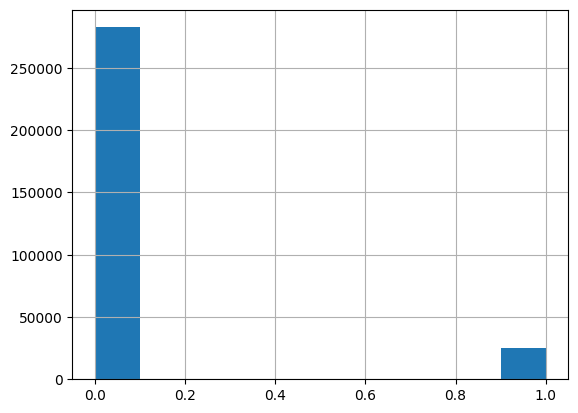

In [ ]:
df_ds_1['TARGET'].hist()

In [112]:
label1_count = df_ds_1[df_ds_1['TARGET'] == 1].shape[0]

label0_idxs = df_ds_1[df_ds_1['TARGET'] == 0].index.to_list()
random.shuffle(label0_idxs)
label0_idxs_downsample = label0_idxs[:int(label1_count*2.5)] # 1.5, убавить обратно или на 2

In [ ]:
label1_count / df_ds_1['TARGET'].shape[0]

0.08077395077522029

In [113]:
df_ds_2 = pd.concat([
    df_ds_1[df_ds_1['TARGET'] == 0].loc[label0_idxs_downsample],
    df_ds_1[df_ds_1['TARGET'] == 1]
])
df_ds_2_anti = df_ds_1.loc[~df_ds_1.index.isin(label0_idxs_downsample)][df_ds_1['TARGET'] == 0]

<ipython-input-113-6564149f2842>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_ds_2_anti = df_ds_1.loc[~df_ds_1.index.isin(label0_idxs_downsample)][df_ds_1['TARGET'] == 0]


<Axes: >

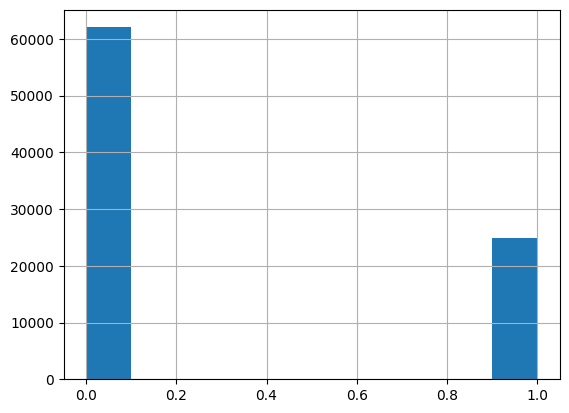

In [ ]:
df_ds_2['TARGET'].hist()

In [114]:
X, y = df_ds_2.drop(columns=['TARGET']), df_ds_2['TARGET']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, stratify=y)

In [115]:
X_train.shape, X_test.shape

((60794, 100), (26055, 100))

In [ ]:
classic_report_dict = defaultdict(list)

for model in [models[0], models[4], models[5]]:
    scores = cross_val_score(
        model,
        X,
        y,
        cv=4,
        n_jobs=2,
        scoring='roc_auc'
    )
    # scores = abs(2*scores - 1)
    classic_report_dict["model"].append(model.__class__.__name__)
    classic_report_dict["cv mean_score"].append(scores.mean())
    classic_report_dict["cv min_score"].append(scores.min())
    classic_report_dict["cv max_score"].append(scores.max())

    model.fit(X_train, y_train)
    classic_report_dict["test score"].append(roc_auc_score(y_test, model.predict_proba(X_test)[:,1]))

    preds_anti_dw = model.predict(df_ds_2_anti.drop(columns=['TARGET']))
    classic_report_dict["anti dw 0"].append(accuracy_score(df_ds_2_anti['TARGET'], preds_anti_dw))
    # break

df_classic_report = pd.DataFrame(classic_report_dict)
df_classic_report

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


,model,cv mean_score,cv min_score,cv max_score,test score,anti dw 0
0,LogisticRegression,0.740204,0.735811,0.742631,0.738166,0.817476
1,RandomForestClassifier,0.735977,0.730613,0.742307,0.731930,0.839681
2,GradientBoostingClassifier,0.750601,0.744212,0.755451,0.747944,0.827620


In [ ]:
import matplotlib.pyplot as plt

<Axes: >

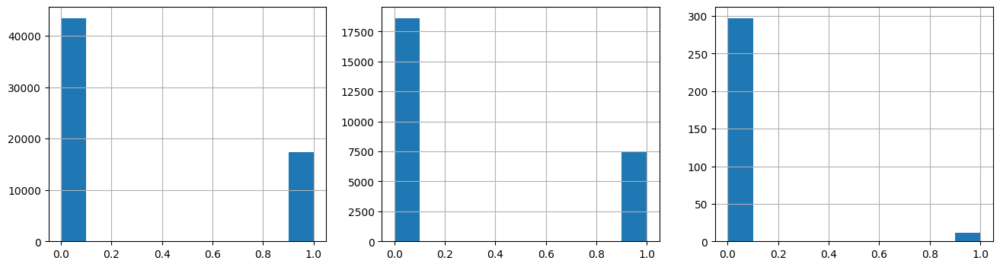

In [ ]:
plt.figure(figsize=(16,4))

plt.subplot(131)
y_train.hist()

plt.subplot(132)
y_test.hist()

plt.subplot(133)
y_val.hist()

<Axes: >

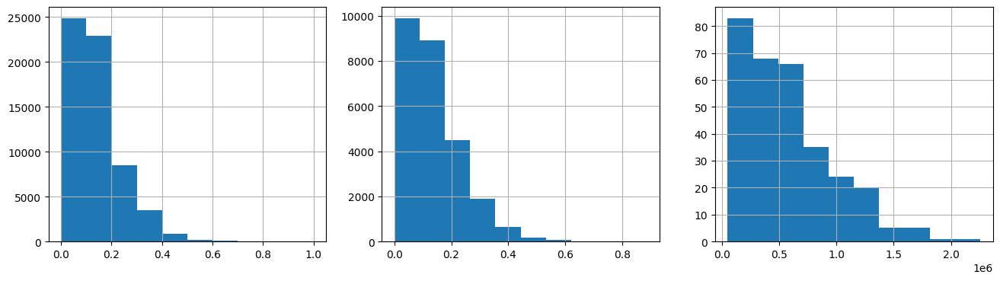

In [ ]:
plt.figure(figsize=(16,4))

plt.subplot(131)
X_train['AMT_CREDIT'].hist()

plt.subplot(132)
X_test['AMT_CREDIT'].hist()

plt.subplot(133)
df_of['AMT_CREDIT'].hist()

<Axes: >

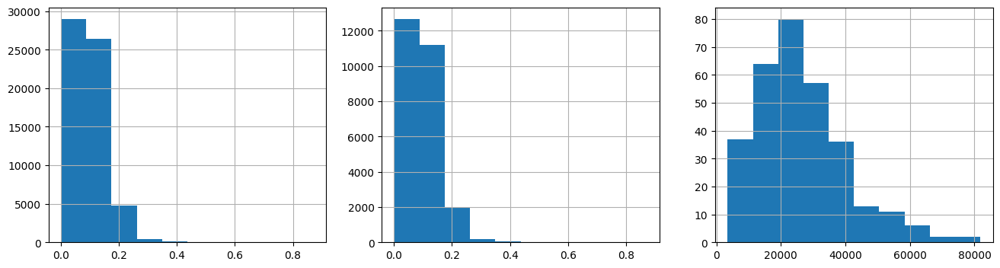

In [ ]:
plt.figure(figsize=(16,4))

plt.subplot(131)
X_train['AMT_ANNUITY'].hist()

plt.subplot(132)
X_test['AMT_ANNUITY'].hist()

plt.subplot(133)
df_of['AMT_ANNUITY'].hist()

In [ ]:
# Дата ликов особо нет
# 1) IV + Nan - пофильтровать
# 2) WOE + NaN

In [ ]:
# PD * (df_app['AMT_ANNUITY'] + df_app['AMT_CREDIT'])

### Val

In [173]:
# df_of = (
#     X_test.drop(columns=['AMT_CREDIT', 'AMT_ANNUITY'])
#     .merge(df_app[['AMT_CREDIT', 'AMT_ANNUITY']].dropna()
#     , left_index=True, right_index=True)
# )

df_of = df_app_val
df_of = df_of[['AMT_CREDIT', 'AMT_ANNUITY']]

In [174]:
df_of

,AMT_CREDIT,AMT_ANNUITY
index,,
237427,1288350.0,37800.0
284232,206280.0,7906.5
163322,402948.0,42444.0
1270,1350000.0,37255.5
206258,472500.0,33016.5
...,...,...
184935,1350000.0,51552.0
157528,2254500.0,56992.5
56206,573628.5,22878.0


In [116]:
def transform_df_app(df):
    df_num = pd.DataFrame(
        imp_num.fit_transform(df.select_dtypes("number"))
    )
    df_num.columns = df.select_dtypes("number").columns
    df_num = df_num.drop(columns=['SK_ID_CURR'])

    df_num[num_normal_cols] = standard_scaler.fit_transform(df_num[num_normal_cols])
    df_num[minmax_cols] = minmax_scaler.fit_transform(df_num[minmax_cols])

    df_cat = pd.DataFrame(
        imp_cat.fit_transform(df.select_dtypes("object"))
    )
    df_cat.columns = df.select_dtypes("object").columns
    df_cat = df_cat.drop(columns=['FONDKAPREMONT_MODE', 'HOUSETYPE_MODE', 'EMERGENCYSTATE_MODE'])

    df_cat_ohe = pd.pandas.get_dummies(df_cat[ohe_cols], dtype=float)

    df_cat_ord = pd.DataFrame(ord_enc.fit_transform(df_cat[ord_cols]))
    df_cat_ord.columns = df_cat[ord_cols].columns

    df_cat_rdy = df_cat_ord.merge(df_cat_ohe, left_index=True, right_index=True)

    df_ds = df_num.merge(df_cat_rdy, left_index=True, right_index=True)
    df_ds = df_ds.drop(columns=cols_filtered_by_IV)

    df_cat_wt = df_cat.merge(df_num, left_index=True, right_index=True)

    for col in cols2woe:
        df_ds[col] = df_cat_wt[col]
        mode = df_ds[col].mode().values[0]
        try:
            df_ds[col] = df_ds[col].apply(lambda x: woe_crutch_mapper(col, x, mode))
        except (KeyError):
            print(col)
            break

    df_ds = df_ds.drop(columns=[
        'REGION_RATING_CLIENT',
        'AMT_REQ_CREDIT_BUREAU_HOUR',
        'AMT_REQ_CREDIT_BUREAU_WEEK',
    ])

    df_ds = df_ds.drop_duplicates()
    return df_ds

In [117]:
t_df_app_val = transform_df_app(df_app_val)
X_val, y_val = t_df_app_val.drop(columns=['TARGET']), t_df_app_val['TARGET']

In [120]:
len(X_train.columns), len(X_val.columns)

(100, 98)

In [121]:
set(X_train.columns).difference(X_val.columns)

{'CODE_GENDER_XNA', 'WALLSMATERIAL_MODE_Monolithic'}

In [122]:
X_val['CODE_GENDER_XNA'] = np.zeros(len(X_val))
X_val['WALLSMATERIAL_MODE_Monolithic'] = np.zeros(len(X_val))
X_val = X_val[X_train.columns]

In [123]:
X_train = X_train.rename(columns=lambda x: re.sub('[^A-Za-z0-9_]+', '', x))
X_test = X_test.rename(columns=lambda x: re.sub('[^A-Za-z0-9_]+', '', x))
X_val = X_val.rename(columns=lambda x: re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
X_val['CODE_GENDER_XNA'] = np.zeros(len(X_val))
X_val['WALLSMATERIAL_MODE_Monolithic'] = np.zeros(len(X_val))
X_val = X_val[X_train.columns]

In [125]:
X_train['target'] = y_train
X_test['target'] = y_test
X_val['target'] = y_val

X_train.to_csv("X_train.csv")
X_test.to_csv("X_test.csv")
X_val.to_csv("X_val.csv")

In [126]:
gdown.download(id='1NJQXL2Iz6Ve9G26LHdfbaFX3M34MzcDq')
gdown.download(id='1mH6d5SWJmiXH6RRkC0ASETGS653P9RRv')
gdown.download(id='1CkMC8G9ylDfniQLLqGSFIy_2IeJSzCID')

Downloading...
From: https://drive.google.com/uc?id=1NJQXL2Iz6Ve9G26LHdfbaFX3M34MzcDq
To: /content/X_train.csv
100%|██████████| 91.5M/91.5M [00:01<00:00, 62.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=1mH6d5SWJmiXH6RRkC0ASETGS653P9RRv
To: /content/X_test.csv
100%|██████████| 39.2M/39.2M [00:01<00:00, 38.3MB/s]
Downloading...
From: https://drive.google.com/uc?id=1CkMC8G9ylDfniQLLqGSFIy_2IeJSzCID
To: /content/X_val.csv
100%|██████████| 458k/458k [00:00<00:00, 29.2MB/s]


'X_val.csv'

In [131]:
train

,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_EMP_PHONE,FLAG_WORK_PHONE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_3,FLAG_DOCUMENT_6,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,FLAG_OWN_CAR,FLAG_OWN_REALTY,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,OCCUPATION_TYPE,ORGANIZATION_TYPE,NAME_CONTRACT_TYPE_Cashloans,NAME_CONTRACT_TYPE_Revolvingloans,CODE_GENDER_F,CODE_GENDER_M,CODE_GENDER_XNA,WALLSMATERIAL_MODE_Block,WALLSMATERIAL_MODE_Mixed,WALLSMATERIAL_MODE_Monolithic,WALLSMATERIAL_MODE_Others,WALLSMATERIAL_MODE_Panel,WALLSMATERIAL_MODE_Stonebrick,WALLSMATERIAL_MODE_Wooden,target
275235,0.000000,0.000769,0.269663,0.122499,0.270483,0.206749,0.220180,1.000000,0.768361,0.416562,0.098901,0.0,0.0,0.052632,0.5,0.695652,0.0,0.0,0.0,0.0,0.0,0.0,-0.422233,0.176464,-0.934993,-0.189838,-0.094244,0.046693,0.013998,-0.164397,-0.368529,-0.082953,-0.280371,-0.082317,-0.141025,-0.149242,-0.205469,-0.100846,-0.230489,-0.192761,-0.098204,0.050225,0.027159,-0.167905,-0.356000,-0.050792,-0.264618,-0.069202,-0.146965,-0.159484,-0.203087,-0.095484,-0.238243,-0.198198,-0.094631,0.045962,0.014281,-0.165971,-0.365361,-0.079132,-0.277939,-0.081119,-0.141875,-0.151415,-0.207252,-0.099728,-0.231774,-0.220667,0.008621,0.029412,0.008721,0.041667,0.732759,0.0,1.0,0.0,0.000000,0.000000,0.04,0.0,1.0,0.026899,0.433399,-0.111430,0.071274,0.038035,0.010581,0.430696,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
280834,0.000000,0.001243,0.177326,0.110495,0.158249,0.254009,0.416911,0.029985,0.896158,0.807559,0.098901,1.0,1.0,0.000000,0.5,0.521739,0.0,0.0,0.0,0.0,0.0,0.0,-0.495035,0.388344,-1.903940,-0.189838,-0.094244,0.046693,0.013998,-0.164397,-0.368529,-0.082953,-0.280371,-0.082317,-0.141025,-0.149242,-0.205469,-0.100846,-0.230489,-0.192761,-0.098204,0.050225,0.027159,-0.167905,-0.356000,-0.050792,-0.264618,-0.069202,-0.146965,-0.159484,-0.203087,-0.095484,-0.238243,-0.198198,-0.094631,0.045962,0.014281,-0.165971,-0.365361,-0.079132,-0.277939,-0.081119,-0.141875,-0.151415,-0.207252,-0.099728,-0.231774,-0.220667,0.002874,0.000000,0.002907,0.000000,0.985089,1.0,0.0,0.0,0.000000,0.007663,0.12,0.0,0.0,-0.012846,-0.188660,-0.111430,-0.015162,0.038035,0.281530,-0.254331,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
62233,0.000000,0.000550,0.073978,0.070604,0.057239,0.069553,0.298591,0.037635,0.841115,0.517577,0.098901,1.0,0.0,0.000000,0.5,0.478261,0.0,0.0,0.0,0.0,0.0,0.0,0.012269,-1.379445,1.831760,-0.189838,-0.094244,0.046693,0.013998,-0.164397,-0.368529,-0.082953,-0.280371,-0.082317,-0.141025,-0.149242,-0.205469,-0.100846,-0.230489,-0.192761,-0.098204,0.050225,0.027159,-0.167905,-0.356000,-0.050792,-0.264618,-0.069202,-0.146965,-0.159484,

In [130]:
train = pd.read_csv("X_train.csv", index_col=0)
test = pd.read_csv("X_test.csv", index_col=0)
val = pd.read_csv("X_val.csv", index_col=0)

X_train, y_train = train.drop(columns=['target']), train['target']
X_test, y_test = test.drop(columns=['target']), test['target']
X_val, y_val = val.drop(columns=['target']), val['target']

### Runs

In [135]:
lgbm_params = {
    "objective": "binary",
    "metric": "auc",
    "num_iterations": 150,
    "num_leaves": 31,
    "early_stopping_rounds": 5,
    "verbosity": 1,
    "seed": 42
}

lgbm_clf = lgb.LGBMClassifier(**lgbm_params)

In [137]:
classic_report_dict = defaultdict(list)

for model in []:#, models[2], models[4], models[5], models[6]]: 0, 4, 5
    scores = cross_val_score(
        model,
        X_train,
        y_train,
        cv=4,
        n_jobs=2,
        scoring='roc_auc'
    )
    # scores = abs(2*scores - 1)
    classic_report_dict["model"].append(model.__class__.__name__)
    classic_report_dict["cv mean_score"].append(scores.mean())
    classic_report_dict["cv min_score"].append(scores.min())
    classic_report_dict["cv max_score"].append(scores.max())

    model.fit(X_train, y_train)
    classic_report_dict["test score"].append(roc_auc_score(y_test, model.predict_proba(X_test)[:,1]))
    classic_report_dict["val score"].append(roc_auc_score(y_val, model.predict_proba(X_val)[:,1]))

    # preds_anti_dw = model.predict(df_ds_2_anti.drop(columns=['TARGET']))
    # classic_report_dict["anti dw 0"].append(accuracy_score(df_ds_2_anti['TARGET'], preds_anti_dw))
    # break

df_classic_report = pd.DataFrame(classic_report_dict)
df_classic_report

ValueError: 
All the 4 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
4 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/sklearn.py", line 1142, in fit
    super().fit(
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/sklearn.py", line 842, in fit
    self._Booster = train(
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/engine.py", line 286, in train
    cb(callback.CallbackEnv(model=booster,
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/callback.py", line 357, in __call__
    self._init(env)
  File "/usr/local/lib/python3.10/dist-packages/lightgbm/callback.py", line 297, in _init
    raise ValueError('For early stopping, '
ValueError: For early stopping, at least one dataset and eval metric is required for evaluation


In [ ]:
svm = models[3]

In [20]:
slgb = models[5]
setattr(models[5], "n_estimators", 90)
setattr(models[5], "max_depth", 3)
slgb.fit(X_train, y_train)

GradientBoostingClassifier(n_estimators=90)

In [25]:
print(roc_auc_score(y_val, slgb.predict_proba(X_val)[:,1]))

0.7477808386899296


In [176]:
df_of['PD_slgb'] = slgb.predict_proba(X_val)[:,1]
print(roc_auc_score(y_val, df_of['PD_slgb'])) # 0.7547123019211927 (X_test), 0.7401285583103766 (X_val), <-dw2, 0.7239057239057238

0.7416590143862871


<ipython-input-176-b655139cd319>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_slgb'] = slgb.predict_proba(X_val)[:,1]


In [175]:
logreg = models[0]
setattr(models[0], "max_iter", 250)
logreg.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(max_iter=250)

In [177]:
df_of['PD_sllg'] = logreg.predict_proba(X_val)[:,1]
print(roc_auc_score(y_val, df_of['PD_sllg']))

0.7884909703091522


<ipython-input-177-55e0a96bb7b0>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_sllg'] = logreg.predict_proba(X_val)[:,1]


In [26]:
rf = models[4]
# setattr(models[4], "n_estimators", 250)
# setattr(models[4], "max_depth", 3)
rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=3, n_estimators=250)

In [29]:
print(roc_auc_score(y_test, rf.predict_proba(X_test)[:,1]))

0.7295215195314599


In [178]:
df_of['PD_slrf'] = rf.predict_proba(X_val)[:,1]
print(roc_auc_score(y_val, df_of['PD_slrf']))

0.6923783287419651


<ipython-input-178-2f7fa4581f68>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_slrf'] = rf.predict_proba(X_val)[:,1]


In [37]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

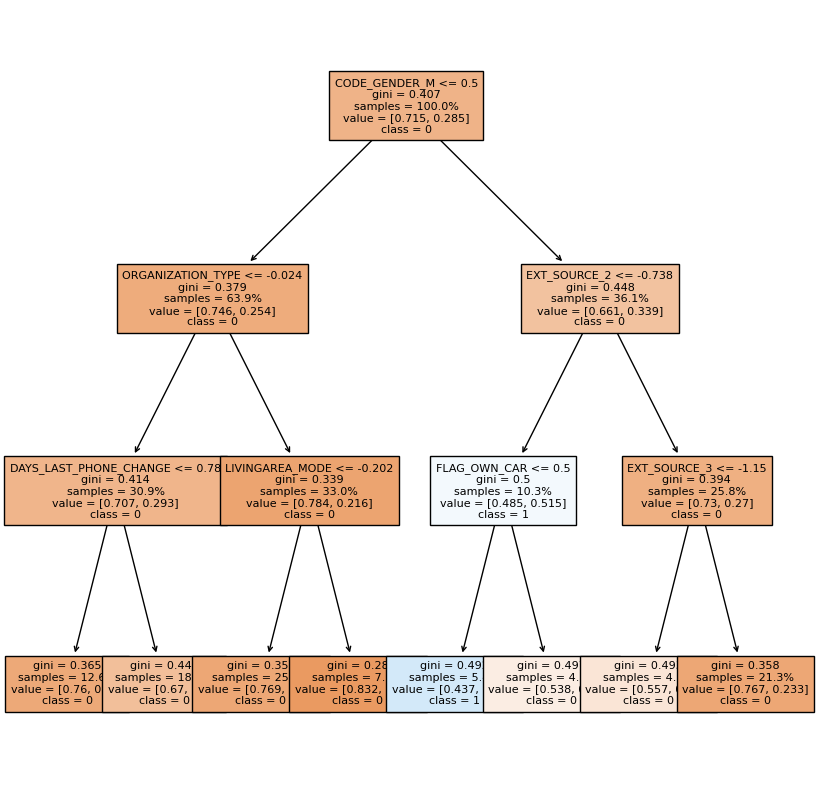

In [49]:
# fig, ax = plt.subplots(figsize=(10,10))

plt.figure(figsize=(10,10))

plot_tree(
    rf.estimators_[3],
    fontsize=8,
    feature_names = X_train.columns.to_list(),
    class_names=['0', '1'],
    filled=True,
    proportion=True,

);

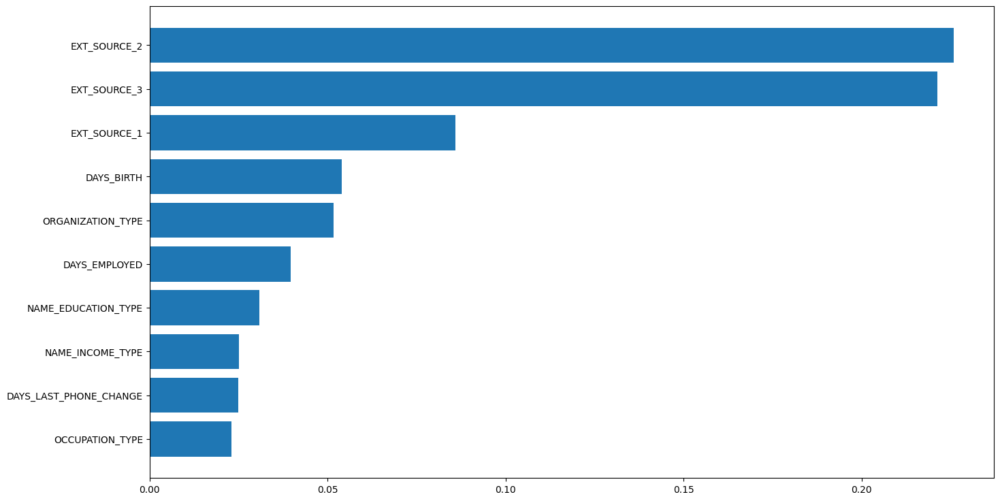

In [71]:
feature_dict = {pair[0]:pair[1] for pair in zip(X_train.columns, rf.feature_importances_)}
feature_df = pd.Series(feature_dict)
feature_df.sort_values(ascending=True, inplace=True)

plt.figure(figsize=(16, 9))
plt.barh(feature_df.index[-10:], feature_df[-10:])
plt.show()

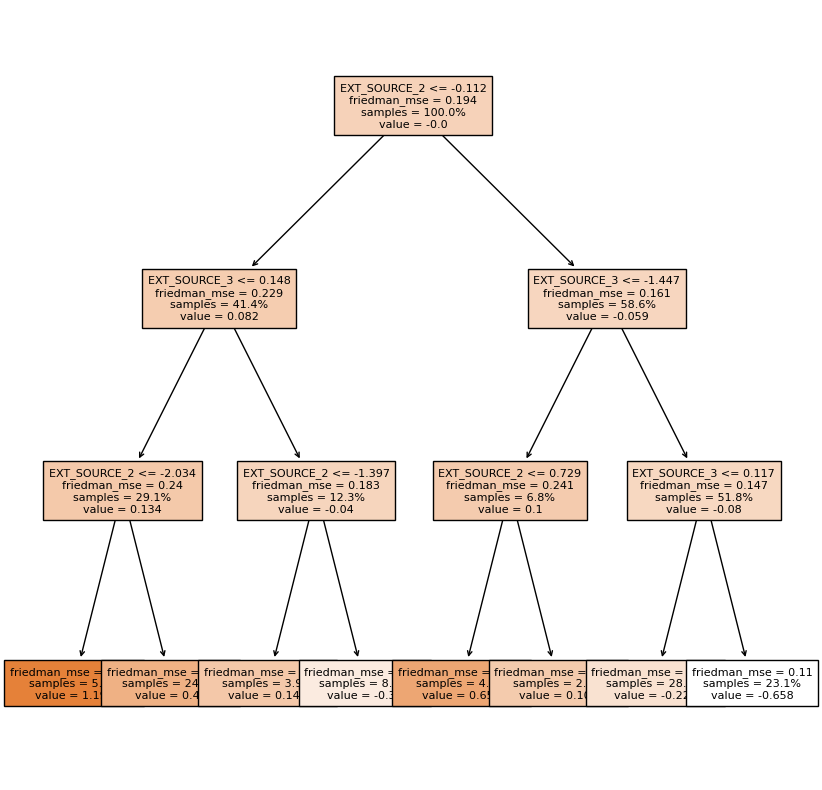

In [53]:
plt.figure(figsize=(10,10))

plot_tree(
    slgb.estimators_[3,0],
    fontsize=8,
    feature_names = X_train.columns.to_list(),
    class_names=['0', '1'],
    filled=True,
    proportion=True,

);

In [66]:
feature_dict = {pair[0]:pair[1] for pair in zip(X_train.columns, slgb.feature_importances_)}
feature_df = pd.Series(feature_dict)
feature_df.sort_values(ascending=True, inplace=True)
feature_df

LIVINGAPARTMENTS_MODE      0.000000
ENTRANCES_AVG              0.000000
NONLIVINGAPARTMENTS_AVG    0.000000
NONLIVINGAREA_AVG          0.000000
YEARS_BUILD_MODE           0.000000
                             ...   
AMT_GOODS_PRICE            0.025857
ORGANIZATION_TYPE          0.032865
EXT_SOURCE_1               0.080726
EXT_SOURCE_2               0.311693
EXT_SOURCE_3               0.325610
Length: 101, dtype: float64

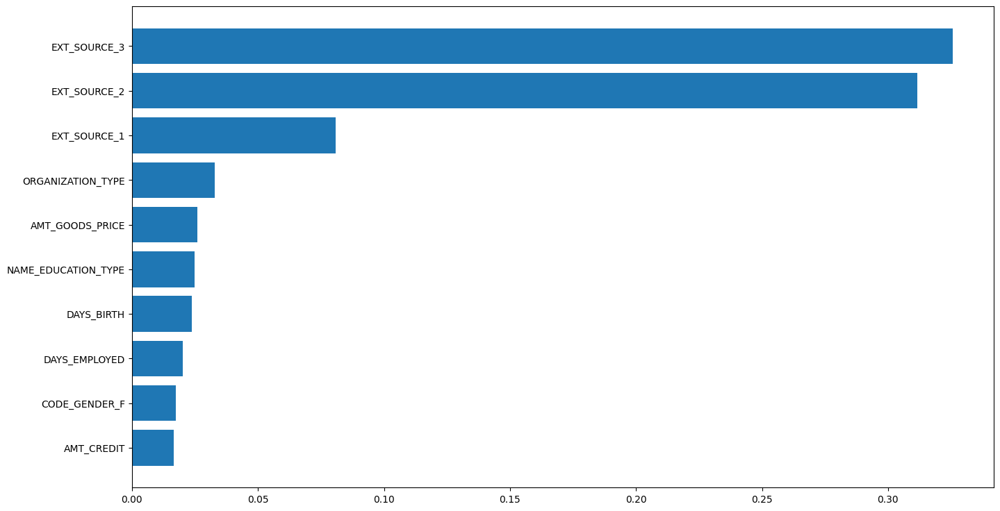

In [70]:
feature_dict = {pair[0]:pair[1] for pair in zip(X_train.columns, slgb.feature_importances_)}
feature_df = pd.Series(feature_dict)
feature_df.sort_values(ascending=True, inplace=True)

plt.figure(figsize=(16, 9))
plt.barh(feature_df.index[-10:], feature_df[-10:])
plt.show()

In [33]:
y_train.unique()


array([0., 1.])

### LightGBM

In [54]:
import lightgbm as lgb
import re

In [57]:
X_train = X_train.rename(columns=lambda x: re.sub('[^A-Za-z0-9_]+', '', x))
X_test.columns = X_train.columns
X_val.columns = X_train.columns

In [138]:
train_dataset = lgb.Dataset(X_train, y_train, feature_name=X_train.columns.to_list())
test_dataset = lgb.Dataset(X_test, y_test, feature_name=X_test.columns.to_list())
val_dataset = lgb.Dataset(X_val, y_val, feature_name=X_val.columns.to_list())

In [142]:
cv_output = lgb.cv(
    {
        "objective": "binary",
        "num_iterations": 150,
        "num_leaves": 31,
        "early_stopping_rounds": 5,
        "verbosity": 1,
        "seed": 42
    },
    train_set=train_dataset,
    num_boost_round=10,
    metrics=["auc"],
    folds=StratifiedShuffleSplit(n_splits=4),
    return_cvbooster=True
)

for key, val in cv_output.items():
    print("\n" + key, " : ", val)

/usr/local/lib/python3.10/dist-packages/lightgbm/engine.py:685: UserWarning: Found 'num_iterations' in params. Will use it instead of 'num_boost_round' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'num_boost_round' argument")


[LightGBM] [Info] Number of positive: 15633, number of negative: 39081
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.812496 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 10555
[LightGBM] [Info] Number of data points in the train set: 54714, number of used features: 99
[LightGBM] [Info] Number of positive: 15633, number of negative: 39081
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.354938 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 10555
[LightGBM] [Info] Number of data points in the train set: 54714, number of used features: 99
[LightGBM] [Info] Number of positive: 15633, number of negative: 39081
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.301398 seconds.
You can set `force_row_wise=true` to re

In [143]:
lgbm_params = {
    "objective": "binary",
    "metric": "auc",
    "num_iterations": 150,
    "num_leaves": 31,
    "early_stopping_rounds": 5,
    "verbosity": 1,
    "seed": 42
}

lgbm_clf = lgb.LGBMClassifier(**lgbm_params)

lgbm_clf.fit(X_train, y_train, eval_set=[(X_test, y_test),])

/usr/local/lib/python3.10/dist-packages/lightgbm/engine.py:172: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] early_stopping_round is set=5, early_stopping_rounds=5 will be ignored. Current value: early_stopping_round=5
[LightGBM] [Info] Number of positive: 17370, number of negative: 43424
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.083620 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 10555
[LightGBM] [Info] Number of data points in the train set: 60794, number of used features: 99
[LightGBM] [Warning] early_stopping_round is set=5, early_stopping_rounds=5 will be ignored. Current value: early_stopping_round=5
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.285719 -> initscore=-0.916268
[LightGBM] [Info] Start training from score -0.916268
Training until validation scores don't improve for 5 rounds
Early stopping, best iteration is:
[89]	valid_0's auc: 0.757567


LGBMClassifier(early_stopping_rounds=5, metric='auc', num_iterations=150,
               objective='binary', seed=42, verbosity=1)

In [179]:
df_of['PD_lgbm'] = lgbm_clf.predict_proba(X_val)[:,1]

<ipython-input-179-889ff42d47b3>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_lgbm'] = lgbm_clf.predict_proba(X_val)[:,1]


In [ ]:
roc_auc_score(y_val, df_of['PD_lgbm'])

0.7486991123354759

In [144]:
roc_auc_score(y_test, lgbm_clf.predict_proba(X_test)[:,1]), roc_auc_score(y_val, lgbm_clf.predict_proba(X_val)[:,1])

(0.7575666872459998, 0.7300275482093664)

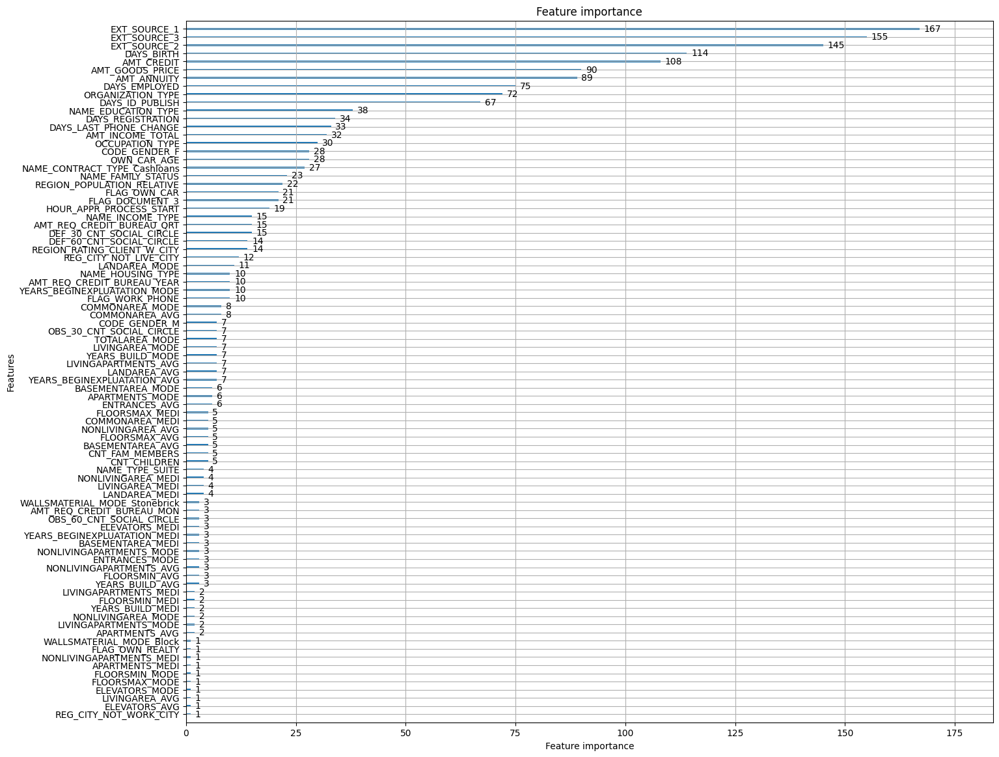

In [ ]:
lgb.plot_importance(lgbm_clf, figsize=(16,14));

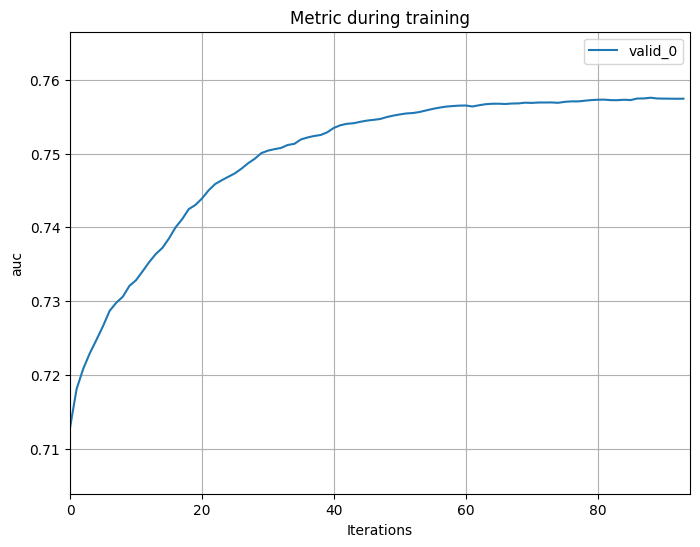

In [215]:
lgb.plot_metric(lgbm_clf, figsize=(8,6));

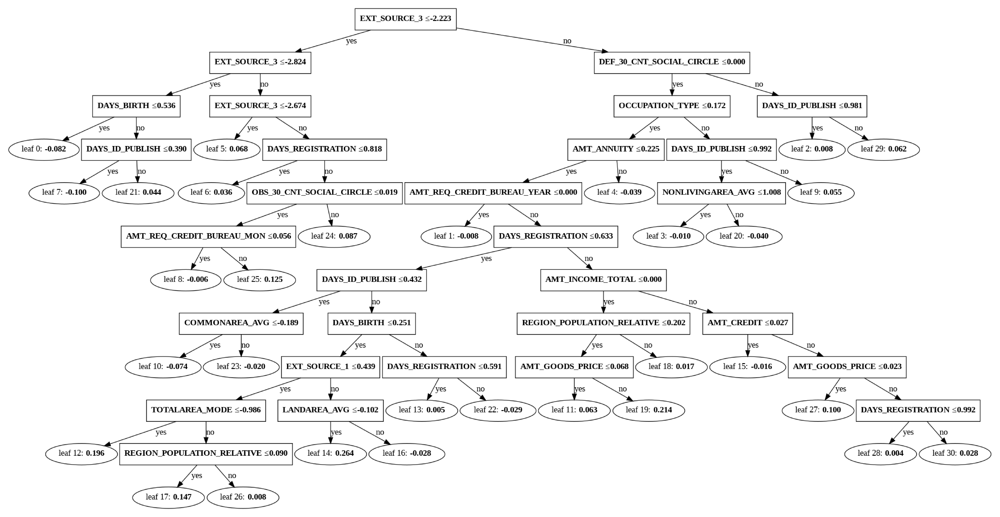

In [60]:
lgb.plot_tree(lgbm_clf, tree_index=42, figsize=(20,18), orientation='vertical', dpi=480);

### Calibration

In [145]:
from sklearn.calibration import CalibratedClassifierCV

In [146]:
X_calib, y_calib = X_test, y_test

In [151]:
from copy import deepcopy

In [185]:
base_clf = deepcopy(logreg)
calibr_sigm = CalibratedClassifierCV(base_clf, cv="prefit", method="sigmoid")
calibr_sigm.fit(X_calib, y_calib)

calibr_isot = CalibratedClassifierCV(base_clf, cv="prefit", method="isotonic")
calibr_isot.fit(X_calib, y_calib)

(
    roc_auc_score(y_val, base_clf.predict_proba(X_val)[:,1]),
    roc_auc_score(y_val, calibr_sigm.predict_proba(X_val)[:,1]),
    roc_auc_score(y_val, calibr_isot.predict_proba(X_val)[:,1])
)

(0.7884909703091522, 0.7884909703091522, 0.7871135598408325)

In [186]:
df_of.columns

Index(['AMT_CREDIT', 'AMT_ANNUITY', 'PD_slgb', 'PD_sllg', 'PD_slrf', 'PD_lgbm',
       'PD_slgb_sigm', 'PD_slgb_isot'],
      dtype='object')

In [187]:
df_of['PD_sllg_sigm'] = calibr_sigm.predict_proba(X_val)[:,1]
df_of['PD_sllg_isot'] = calibr_isot.predict_proba(X_val)[:,1]

<ipython-input-187-4d8e80b57239>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_sllg_sigm'] = calibr_sigm.predict_proba(X_val)[:,1]
<ipython-input-187-4d8e80b57239>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_sllg_isot'] = calibr_isot.predict_proba(X_val)[:,1]


In [181]:
base_clf = deepcopy(slgb)
calibr_sigm = CalibratedClassifierCV(base_clf, cv="prefit", method="sigmoid")
calibr_sigm.fit(X_calib, y_calib)

calibr_isot = CalibratedClassifierCV(base_clf, cv="prefit", method="isotonic")
calibr_isot.fit(X_calib, y_calib)

(
    roc_auc_score(y_val, base_clf.predict_proba(X_val)[:,1]),
    roc_auc_score(y_val, calibr_sigm.predict_proba(X_val)[:,1]),
    roc_auc_score(y_val, calibr_isot.predict_proba(X_val)[:,1])
)

(0.7416590143862871, 0.7416590143862871, 0.7439546985001532)

In [182]:
df_of['PD_slgb_sigm'] = calibr_sigm.predict_proba(X_val)[:,1]
df_of['PD_slgb_isot'] = calibr_isot.predict_proba(X_val)[:,1]

<ipython-input-182-74fbef934971>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_slgb_sigm'] = calibr_sigm.predict_proba(X_val)[:,1]
<ipython-input-182-74fbef934971>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_slgb_isot'] = calibr_isot.predict_proba(X_val)[:,1]


(array([4.700e+01, 2.164e+03, 5.594e+03, 2.716e+03, 2.488e+03, 2.246e+03,
        1.976e+03, 1.845e+03, 2.837e+03, 8.000e+02, 6.050e+02, 9.910e+02,
        1.114e+03, 2.250e+02, 4.030e+02, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 4.000e+00]),
 array([0.  , 0.05, 0.1 , 0.15, 0.2 , 0.25, 0.3 , 0.35, 0.4 , 0.45, 0.5 ,
        0.55, 0.6 , 0.65, 0.7 , 0.75, 0.8 , 0.85, 0.9 , 0.95, 1.  ]),
 <BarContainer object of 20 artists>)

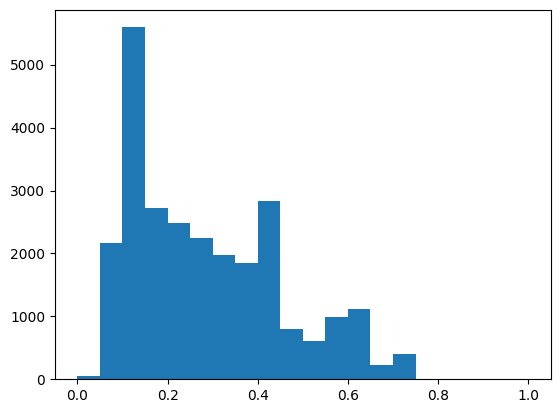

In [172]:
plt.hist(calibr_isot.predict_proba(X_test)[:,1],bins=20)

In [153]:
deepcopy(rf) is rf

False

In [188]:
base_clf = deepcopy(rf)
calibr_sigm = CalibratedClassifierCV(base_clf, cv="prefit", method="sigmoid")
calibr_sigm.fit(X_calib, y_calib)

print(
    roc_auc_score(y_val, rf.predict_proba(X_val)[:,1]),
    roc_auc_score(y_val, base_clf.predict_proba(X_val)[:,1]),
    # roc_auc_score(y_val, calibr_sigm.predict_proba(X_val)[:,1]),
    # roc_auc_score(y_val, calibr_isot.predict_proba(X_val)[:,1])
)

base_clf = deepcopy(rf)
calibr_isot = CalibratedClassifierCV(base_clf, cv="prefit", method="isotonic")
calibr_isot.fit(X_calib, y_calib)

(
    roc_auc_score(y_val, rf.predict_proba(X_val)[:,1]),
    roc_auc_score(y_val, base_clf.predict_proba(X_val)[:,1]),
    # roc_auc_score(y_val, calibr_sigm.predict_proba(X_val)[:,1]),
    # roc_auc_score(y_val, calibr_isot.predict_proba(X_val)[:,1])
)

0.6923783287419651 0.6923783287419651


(0.6923783287419651, 0.6923783287419651)

In [189]:
df_of['PD_slrf_sigm'] = calibr_sigm.predict_proba(X_val)[:,1]
df_of['PD_slrf_isot'] = calibr_isot.predict_proba(X_val)[:,1]

<ipython-input-189-78b55abf240d>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_slrf_sigm'] = calibr_sigm.predict_proba(X_val)[:,1]
<ipython-input-189-78b55abf240d>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_slrf_isot'] = calibr_isot.predict_proba(X_val)[:,1]


In [190]:
base_clf = deepcopy(lgbm_clf)
calibr_sigm = CalibratedClassifierCV(base_clf, cv="prefit", method="sigmoid")
calibr_sigm.fit(X_calib, y_calib)

calibr_isot = CalibratedClassifierCV(base_clf, cv="prefit", method="isotonic")
calibr_isot.fit(X_calib, y_calib)

(
    roc_auc_score(y_val, base_clf.predict_proba(X_val)[:,1]),
    roc_auc_score(y_val, calibr_sigm.predict_proba(X_val)[:,1]),
    roc_auc_score(y_val, calibr_isot.predict_proba(X_val)[:,1])
)

(0.7300275482093664, 0.7300275482093664, 0.7318640955004592)

In [191]:
df_of['PD_lgbm_sigm'] = calibr_sigm.predict_proba(X_val)[:,1]
df_of['PD_lgbm_isot'] = calibr_isot.predict_proba(X_val)[:,1]

<ipython-input-191-8a04baa7e413>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_lgbm_sigm'] = calibr_sigm.predict_proba(X_val)[:,1]
<ipython-input-191-8a04baa7e413>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_of['PD_lgbm_isot'] = calibr_isot.predict_proba(X_val)[:,1]


In [210]:
df_of = df_of.iloc[:,:14]

In [211]:
for pd_col in df_of.columns[2:]:
    df_of[pd_col+'_auc'] = roc_auc_score(y_val, df_of[pd_col])

In [214]:
df_of

,AMT_CREDIT,AMT_ANNUITY,PD_slgb,PD_sllg,PD_slrf,PD_lgbm,PD_slgb_sigm,PD_slgb_isot,PD_sllg_sigm,PD_sllg_isot,PD_slrf_sigm,PD_slrf_isot,PD_lgbm_sigm,PD_lgbm_isot,PD_slgb_auc,PD_sllg_auc,PD_slrf_auc,PD_lgbm_auc,PD_slgb_sigm_auc,PD_slgb_isot_auc,PD_sllg_sigm_auc,PD_sllg_isot_auc,PD_slrf_sigm_auc,PD_slrf_isot_auc,PD_lgbm_sigm_auc,PD_lgbm_isot_auc
index,,,,,,,,,,,,,,,,,,,,,,,,,,
237427,1288350.0,37800.0,0.385623,0.829638,0.293221,0.674607,0.393141,0.387569,0.827102,0.855422,0.280702,0.315848,0.715345,0.659091,0.741659,0.788491,0.692378,0.730028,0.741659,0.743955,0.788491,0.787114,0.692378,0.688399,0.730028,0.731864
284232,206280.0,7906.5,0.251415,0.296336,0.330790,0.250630,0.241942,0.257121,0.293719,0.286503,0.414295,0.429658,0.222348,0.269422,0.741659,0.788491,0.692378,0.730028,0.741659,0.743955,0.788491,0.787114,0.692378,0.688399,0.730028,0.731864
163322,402948.0,42444.0,0.375551,0.813012,0.322574,0.456976,0.381663,0.375000,0.810322,0.745763,0.383125,0.404727,0.451602,0.478788,0.741659,0.788491,0.692378,0.730028,0.741659,0.743955,0.788491,0.787114,0.692378,0.688399,0.730028,0.731864
1270,1350000.0,37255.5,0.189314,0.148187,0.232928,0.039957,0.174586,0.178723,0.146843,0.135642,0.130622,0.122195,0.088503,0.020690,0.741659,0.788491,0.692378,0.730028,0.741659,0.743955,0.788491,0.787114,0.692378,0.688399,0.730028,0.731864
206258,472500.0,33016.5,0.149260,0.276567,0.217079,0.125709,0.132712,0.127986,0.274097,0.286503,0.104670,0.092754,0.130966,0.107890,0.741659,0.788491,0.692378,0.730028,0.741659,0.743955,0.788491,0.787114,0.692378,0.688399,0.730028,0.731864
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
184935,1350000.0,51552.0,0.244041,0.063657,0.214738,0.073389,0.233820,0.257121,0.063143,0.058824,0.101248,0.092754,0.103339,0.055092,0.741659,0.788491,0.692378,0.730028,0.741659,0.743955,0.788491,0.787114,0.692378,0.688399,0.730028,0.731864
157528,2254500.0,56992.5,0.078983,0.063538,0.218364,0.055964,0.063710,0.062140,0.063024,0.058824,0.106592,0.119712,0.095350,0.055092,0.741659,0.788491,0.692378,0.730028,0.741659,0.743955,0.788491,0.787114,0.692378,0.688399,0.730028,0.731864
56206,573628.5,22878.0,0.309180,0.215917,0.310342,0.236353,0.306399,0.303390,0.213948,0.232785,0.338510,0.363971,0.209950,0.246929,0.741659,0.788491,0.692378,0.730028,0.741659,0.743955,0.788491,0.787114,0.692378,0.688399,0.730028,0.731864


In [213]:
df_of.to_csv("various_PD_for_offering_aucs.csv")

### SHAP

In [217]:
! pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.5/540.5 kB 7.0 MB/s eta 0:00:00


In [218]:
import shap

#### GB

In [221]:
X, y = pd.concat([X_train, X_test]), pd.concat([y_train, y_test])

In [367]:
explainer = shap.TreeExplainer(slgb)


In [368]:
shap_values = explainer(X_test)

shap_values_val = explainer(X_val)

In [331]:
slgb.predict_proba(X_test)[:10]

array([[0.88613359, 0.11386641],
       [0.7085848 , 0.2914152 ],
       [0.62485092, 0.37514908],
       [0.64502837, 0.35497163],
       [0.8608972 , 0.1391028 ],
       [0.67225136, 0.32774864],
       [0.78396482, 0.21603518],
       [0.59477537, 0.40522463],
       [0.4979256 , 0.5020744 ],
       [0.23806492, 0.76193508]])

In [332]:
shap.initjs()

shap.force_plot(
    explainer.expected_value, shap_values.values[9, :], X_test.columns
)

In [333]:
slgb.predict_proba(X_val)[50:60]

array([[0.33846102, 0.66153898],
       [0.89874931, 0.10125069],
       [0.59449092, 0.40550908],
       [0.86995186, 0.13004814],
       [0.88448817, 0.11551183],
       [0.89348354, 0.10651646],
       [0.87703956, 0.12296044],
       [0.74259498, 0.25740502],
       [0.83124423, 0.16875577],
       [0.87552994, 0.12447006]])

In [337]:
shap.initjs()

shap.force_plot(
    explainer.expected_value, shap_values_val.values[51, :], X_val.columns
)

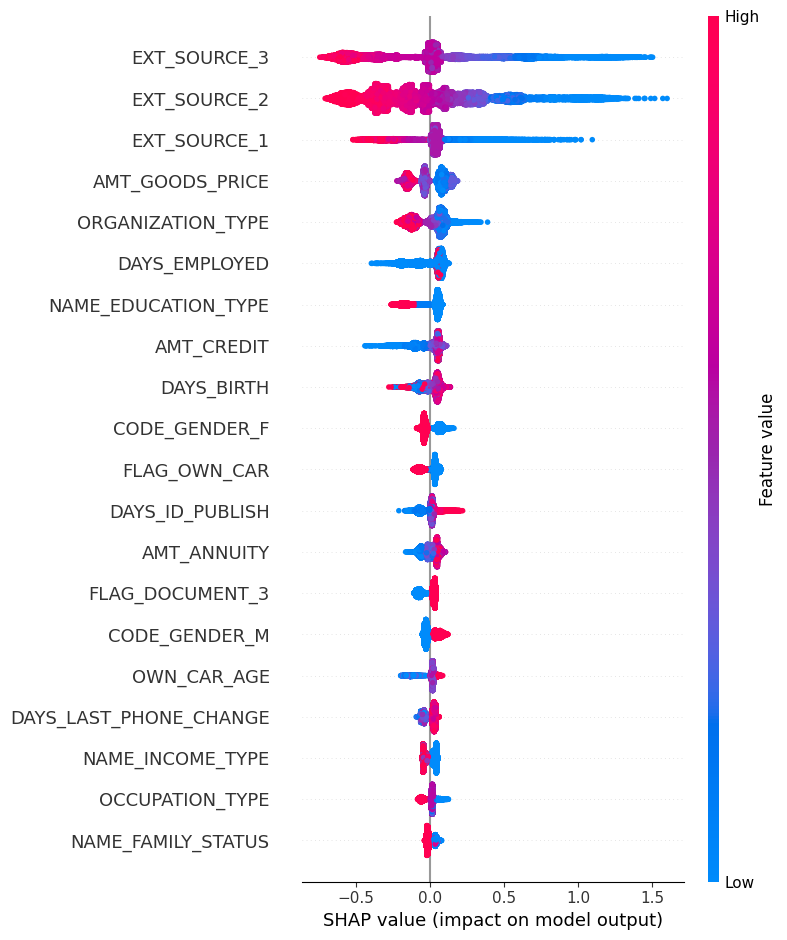

In [370]:
shap.summary_plot(shap_values, X_test)

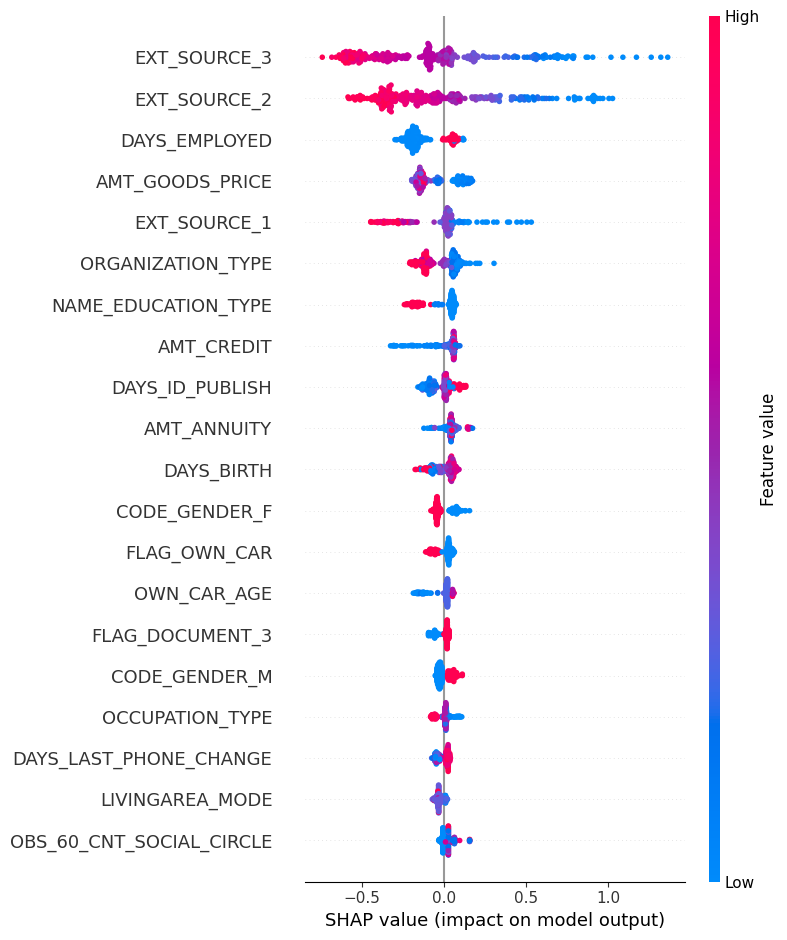

In [369]:
shap.summary_plot(shap_values_val, X_val)

In [371]:
shap_values_val.shape

(308, 100)

## RF

In [383]:
explainer = shap.TreeExplainer(rf)
shap_values = explainer(X_test)

shap_values_val = explainer(X_val)

In [401]:
np.argmax(rf.predict_proba(X_test)[:,1])

15187

In [403]:
rf.predict_proba(X_test)[15187]

array([0.54531327, 0.45468673])

In [375]:
shap_values[:,:,1].shape

(26055, 100)

In [393]:
shap_values.values[:,:,1].shape

(26055, 100)

In [396]:
explainer.expected_value.shape

(2,)

In [402]:
shap.initjs()

shap.force_plot(
    explainer.expected_value[1], shap_values.values[15187, :, 1], X_test.columns
)

In [407]:
np.argmin(rf.predict_proba(X_val)[:,1])

166

In [405]:
rf.predict_proba(X_val)[69]

array([0.57510344, 0.42489656])

In [408]:
shap.initjs()

shap.force_plot(
    explainer.expected_value[1], shap_values_val.values[166, :, 1], X_test.columns
)

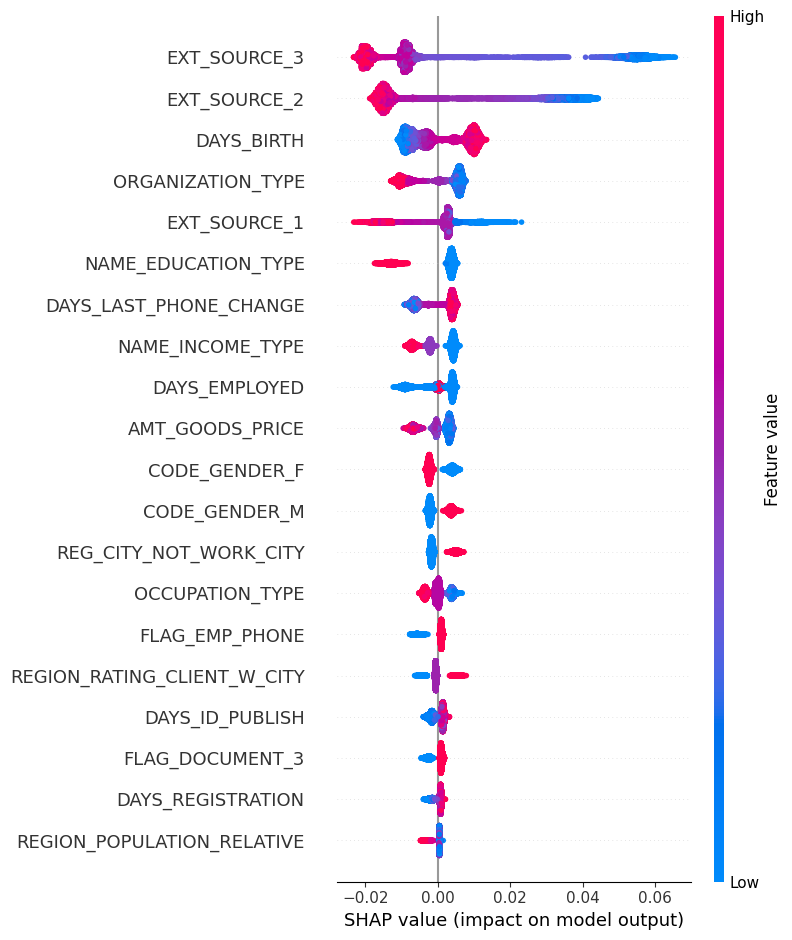

In [379]:

shap.summary_plot(shap_values[:,:,1], X_test)

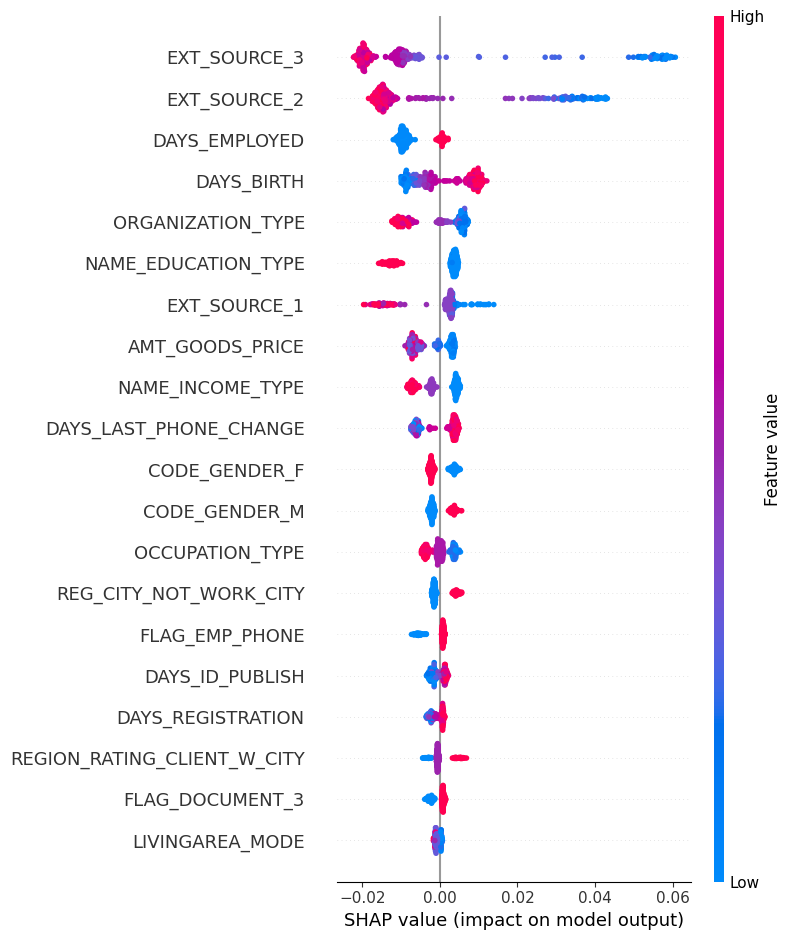

In [376]:

shap.summary_plot(shap_values_val[:,:,1], X_val)

In [378]:

# shap.summary_plot(shap_values_val[:,:,0], X_val)

#### LGBM

In [380]:
explainer = shap.TreeExplainer(lgbm_clf)
shap_values = explainer(X_test)
shap_values_val = explainer(X_val)

In [340]:
lgbm_clf.predict_proba(X_test)[:10]

array([[0.89666848, 0.10333152],
       [0.76496389, 0.23503611],
       [0.55891112, 0.44108888],
       [0.59858015, 0.40141985],
       [0.85473361, 0.14526639],
       [0.66397865, 0.33602135],
       [0.79567004, 0.20432996],
       [0.54817758, 0.45182242],
       [0.51868131, 0.48131869],
       [0.25175762, 0.74824238]])

In [345]:
shap.initjs()

shap.force_plot(
    explainer.expected_value, shap_values.values[9, :], X_test.columns
)

In [359]:
lgbm_clf.predict_proba(X_val)[150:156]

array([[0.911523  , 0.088477  ],
       [0.93559378, 0.06440622],
       [0.25431703, 0.74568297],
       [0.8439261 , 0.1560739 ],
       [0.80197125, 0.19802875],
       [0.88973083, 0.11026917]])

In [360]:
shap.initjs()

shap.force_plot(
    explainer.expected_value, shap_values_val.values[152, :], X_test.columns
)

In [ ]:
shap.initjs()

shap.force_plot(
    explainer.expected_value, shap_values_val.values[2, :], X_val.iloc[2, :]
)

In [ ]:
shap.initjs()

shap.force_plot(
    explainer.expected_value, shap_values_val.values[y_val == 1, :][7], X_val[y_val == 1].iloc[7, :]
)

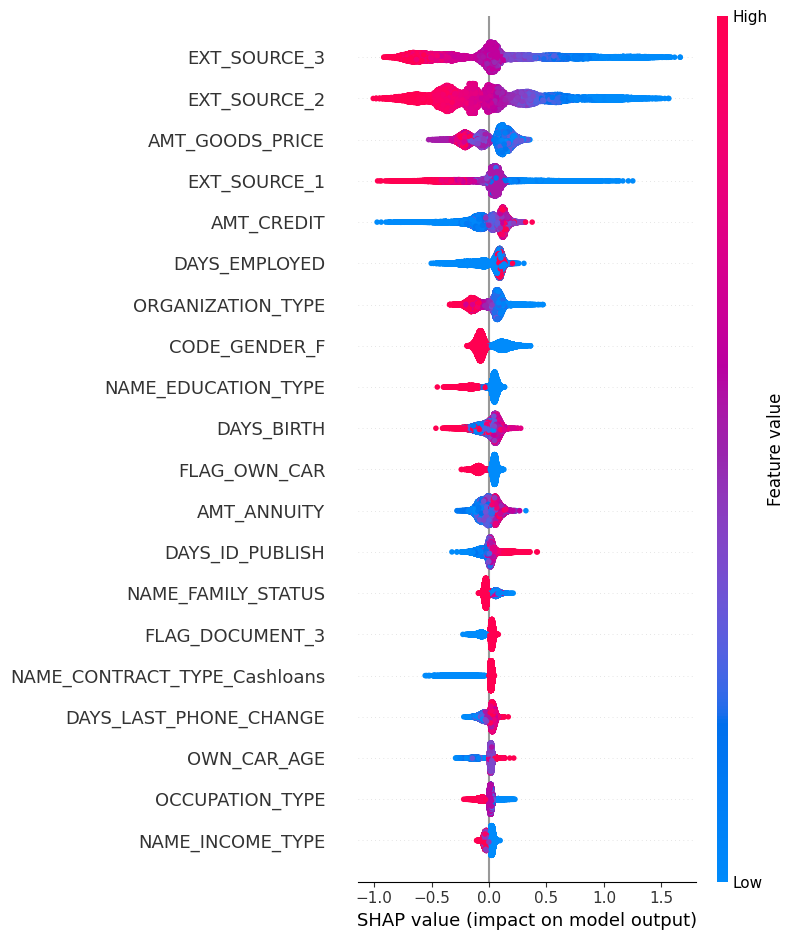

In [381]:
shap.summary_plot(shap_values, X_test)

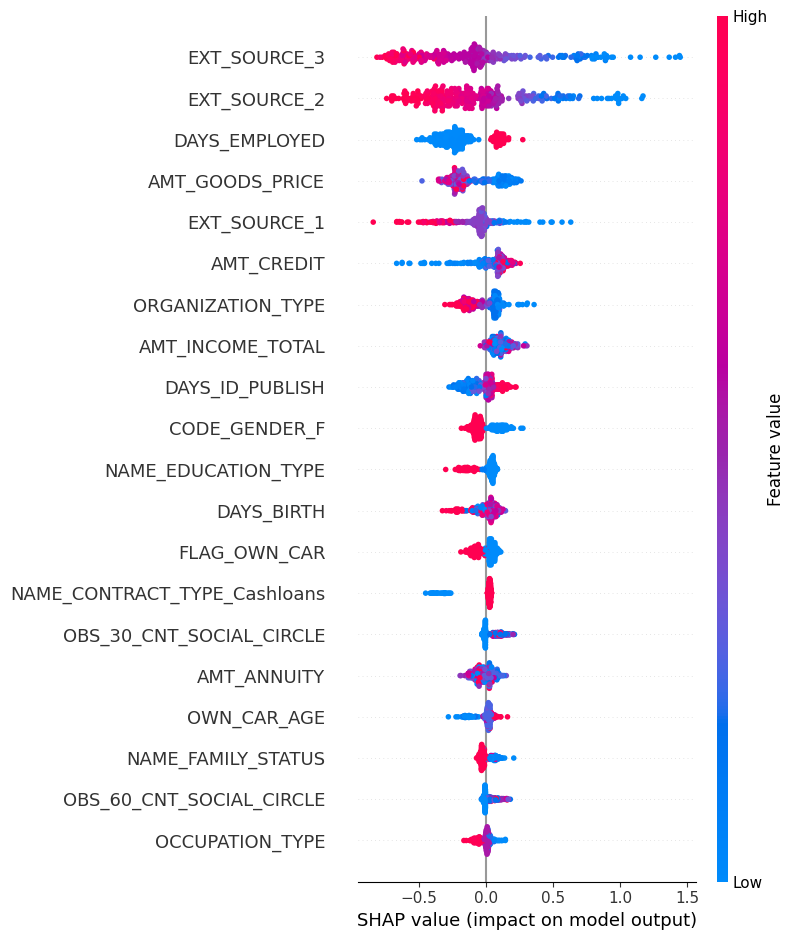

In [382]:

shap.summary_plot(shap_values_val, X_val)

## Limits, offers

In [ ]:
df_of['Risk'] = np.round(df_of['AMT_CREDIT']*np.power(df_of['PD_raw'], 1.5), 1)
df_of

In [ ]:
from scipy.optimize import LinearConstraint, milp

In [ ]:
df_of_1 = df_of[df_of['PD_raw'] <= 0.46]
df_of_1

<Axes: >

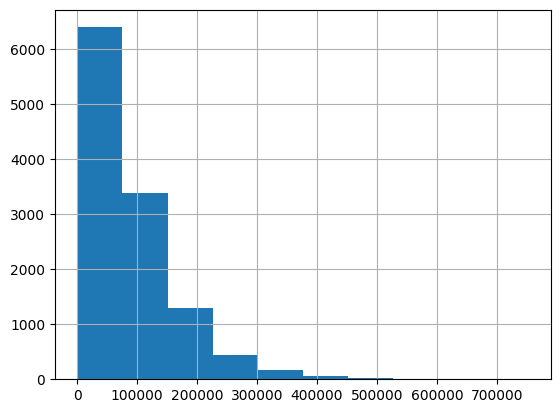

In [ ]:
df_of_1['Risk'].hist()

In [ ]:
df_of_1_trunc = df_of_1.iloc[:100]

In [ ]:
df_of_1_trunc

,AMT_CREDIT,AMT_ANNUITY,PD_raw,Risk
177781,337500.0,16875.0,0.431258,95582.8
267064,225000.0,16951.5,0.206530,21118.2
65227,180000.0,9000.0,0.434616,51574.0
58769,152820.0,15016.5,0.120612,6401.3
5909,704844.0,31176.0,0.311729,122675.8
...,...,...,...,...
126981,1125000.0,59940.0,0.281211,167764.7
276740,147888.0,7321.5,0.205094,13736.0
159652,397881.0,26032.5,0.444746,118010.6
113312,188460.0,12879.0,0.431099,53343.8


In [ ]:
def run_mlip(df):
    ia = np.array(df_of_1['AMT_ANNUITY'])
    r = np.array(df_of_1['Risk'])

    c = -ia

    A = np.identity(c.shape[0])
    b_l = np.zeros_like(c)
    b_u = np.ones_like(c)
    constraint_1 = LinearConstraint(A=A, lb=b_l, ub=b_u)
    constraint_2 = LinearConstraint(A=r, lb=0, ub=200000)

    integrality = np.ones_like(c)

    res = milp(c=c, constraints=[constraint_1, constraint_2], integrality=integrality)
    print(res.message, res.status)

    return res

In [ ]:
# c.ndim != 1 or c.size == 0 or not np.all(np.isfinite(c))

False

In [ ]:
%%time
res = run_mlip(df_of_1_trunc)
x = res.x

In [ ]:
print(f'Total profit from interest: {-c@x:.4f}')
print(f'Total risk: {r@x:.4f}')
print(f'No. clients who were approved: {sum(x)}')

Total profit from interest: 913135.5000
Total risk: 199974.6000
No. clients who were approved: 31.0
